In [ ]:
!pip install scikit-learn-extra

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 9.8 MB/s eta 0:00:00


In [ ]:
!pip install pyclustering

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 11.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyclustering: filename=pyclustering-0.10.1.2-py3-none-any.whl size=2395103 sha256=9969bd6b8ed2186f4be59ecceb6f5ac8943a2a1fda916699bc8219ceef53b874
  Stored in directory: /root/.cache/pip/wheels/b5/42/97/11eee99f5c1e4fdfc170f0a54f9c9eb195df66edb4cf69f449
Successfully built pyclustering


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn import datasets
from sklearn import feature_selection

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix


from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.metrics import pairwise_distances


In [ ]:
data_dir = "/content/loan_approval_dataset.csv"
df = pd.read_csv(data_dir)
df.head()

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,9600000,29900000,12,778,2400000,17600000,22700000,8000000,Approved
1,2,0,Not Graduate,Yes,4100000,12200000,8,417,2700000,2200000,8800000,3300000,Rejected
2,3,3,Graduate,No,9100000,29700000,20,506,7100000,4500000,33300000,12800000,Rejected
3,4,3,Graduate,No,8200000,30700000,8,467,18200000,3300000,23300000,7900000,Rejected
4,5,5,Not Graduate,Yes,9800000,24200000,20,382,12400000,8200000,29400000,5000000,Rejected


### **1.Basic EDA:**

In [ ]:
df.describe()

,loan_id,no_of_dependents,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value
count,4269.000000,4269.000000,4.269000e+03,4.269000e+03,4269.000000,4269.000000,4.269000e+03,4.269000e+03,4.269000e+03,4.269000e+03
mean,2135.000000,2.498712,5.059124e+06,1.513345e+07,10.900445,599.936051,7.472617e+06,4.973155e+06,1.512631e+07,4.976692e+06
std,1232.498479,1.695910,2.806840e+06,9.043363e+06,5.709187,172.430401,6.503637e+06,4.388966e+06,9.103754e+06,3.250185e+06
min,1.000000,0.000000,2.000000e+05,3.000000e+05,2.000000,300.000000,-1.000000e+05,0.000000e+00,3.000000e+05,0.000000e+00
25%,1068.000000,1.000000,2.700000e+06,7.700000e+06,6.000000,453.000000,2.200000e+06,1.300000e+06,7.500000e+06,2.300000e+06
50%,2135.000000,3.000000,5.100000e+06,1.450000e+07,10.000000,600.000000,5.600000e+06,3.700000e+06,1.460000e+07,4.600000e+06
75%,3202.000000,4.000000,7.500000e+06,2.150000e+07,16.000000,748.000000,1.130000e+07,7.600000e+06,2.170000e+07,7.100000e+06
max,4269.000000,5.000000,9.900000e+06,3.950000e+07,20.000000,900.000000,2.910000e+07,1.940000e+07,3.920000e+07,1.470000e+07


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   loan_id                    4269 non-null   int64 
 1    no_of_dependents          4269 non-null   int64 
 2    education                 4269 non-null   object
 3    self_employed             4269 non-null   object
 4    income_annum              4269 non-null   int64 
 5    loan_amount               4269 non-null   int64 
 6    loan_term                 4269 non-null   int64 
 7    cibil_score               4269 non-null   int64 
 8    residential_assets_value  4269 non-null   int64 
 9    commercial_assets_value   4269 non-null   int64 
 10   luxury_assets_value       4269 non-null   int64 
 11   bank_asset_value          4269 non-null   int64 
 12   loan_status               4269 non-null   object
dtypes: int64(10), object(3)
memory usage: 433.7+ KB


In [ ]:
print ("Number of rows:" )
print(df.shape[0])
print ("Number of columns: ")
df.shape[1]

Number of rows:
4269
Number of columns: 


13

In [ ]:
def print_unique_values_for_categorical_columns(df):
    categorical_columns = df.select_dtypes(include=['category', 'object'])

    for column in categorical_columns:
        unique_values = df[column].unique()
        print(f"Unique values in column '{column}':\n{unique_values}\n")

print_unique_values_for_categorical_columns(df)

Unique values in column ' education':
[' Graduate' ' Not Graduate']

Unique values in column ' self_employed':
[' No' ' Yes']

Unique values in column ' loan_status':
[' Approved' ' Rejected']



In [ ]:
def calculate_null_summary(dataframe):
    perc_null = (dataframe.isnull().sum() / len(dataframe)) * 100
    return  perc_null
perc_null = calculate_null_summary(df)
print(perc_null)

loan_id                      0.0
 no_of_dependents            0.0
 education                   0.0
 self_employed               0.0
 income_annum                0.0
 loan_amount                 0.0
 loan_term                   0.0
 cibil_score                 0.0
 residential_assets_value    0.0
 commercial_assets_value     0.0
 luxury_assets_value         0.0
 bank_asset_value            0.0
 loan_status                 0.0
dtype: float64


# **2.Data Cleaning:**

> **1.   Renaming of Column Names to remove inconsistencies:**

In [ ]:
df.columns

Index(['loan_id', ' no_of_dependents', ' education', ' self_employed',
       ' income_annum', ' loan_amount', ' loan_term', ' cibil_score',
       ' residential_assets_value', ' commercial_assets_value',
       ' luxury_assets_value', ' bank_asset_value', ' loan_status'],
      dtype='object')

In [ ]:
df.rename(columns=dict(zip(df.columns,df.columns.str.strip())),inplace=True)

In [ ]:
df.columns

Index(['loan_id', 'no_of_dependents', 'education', 'self_employed',
       'income_annum', 'loan_amount', 'loan_term', 'cibil_score',
       'residential_assets_value', 'commercial_assets_value',
       'luxury_assets_value', 'bank_asset_value', 'loan_status'],
      dtype='object')



> **2.   Encoding Categorical Columns into Numerical Columns:**


In [ ]:
df.dtypes

loan_id                      int64
no_of_dependents             int64
education                   object
self_employed               object
income_annum                 int64
loan_amount                  int64
loan_term                    int64
cibil_score                  int64
residential_assets_value     int64
commercial_assets_value      int64
luxury_assets_value          int64
bank_asset_value             int64
loan_status                 object
dtype: object

In [ ]:
label_encoder = LabelEncoder()

df['education'] = label_encoder.fit_transform(df['education'])
df['self_employed'] = label_encoder.fit_transform(df['self_employed'])
df['loan_status'] = label_encoder.fit_transform(df['loan_status'])

df.head()

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,0,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,0
1,2,0,1,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,1
2,3,3,0,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,1
3,4,3,0,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,1
4,5,5,1,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,1


In [ ]:
df.dtypes

loan_id                     int64
no_of_dependents            int64
education                   int64
self_employed               int64
income_annum                int64
loan_amount                 int64
loan_term                   int64
cibil_score                 int64
residential_assets_value    int64
commercial_assets_value     int64
luxury_assets_value         int64
bank_asset_value            int64
loan_status                 int64
dtype: object

> **3.   Dropping the loan_id Column:**

In [ ]:
df.drop(['loan_id'], axis = 1, inplace = True)
df.head()

,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,2,0,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,0
1,0,1,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,1
2,3,0,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,1
3,3,0,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,1
4,5,1,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,1


In [ ]:
new_pca_df =df

> **4.   Scalling the numerical columns:**

In [ ]:
scaler = StandardScaler()

x = df.drop(columns=['loan_status'])
y = df['loan_status']


numerical_columns = ['no_of_dependents', 'income_annum', 'loan_amount', 'loan_term', 'cibil_score',
                      'residential_assets_value', 'commercial_assets_value', 'luxury_assets_value',
                      'bank_asset_value']

x[numerical_columns] = scaler.fit_transform(x[numerical_columns])


print("Scaled Feature Variables (x):")
print(x.head())

print("\nTarget Variable (y):")
print(y.head())

Scaled Feature Variables (x):
   no_of_dependents  education  self_employed  income_annum  loan_amount  \
0         -0.294102          0              0      1.617979     1.633052   
1         -1.473548          1              1     -0.341750    -0.324414   
2          0.295621          0              0      1.439822     1.610933   
3          0.295621          0              0      1.119139     1.721525   
4          1.475067          1              1      1.689242     1.002681   

   loan_term  cibil_score  residential_assets_value  commercial_assets_value  \
0   0.192617     1.032792                 -0.780058                 2.877289   
1  -0.508091    -1.061051                 -0.733924                -0.631921   
2   1.594031    -0.544840                 -0.057300                -0.107818   
3  -0.508091    -0.771045                  1.649637                -0.381263   
4   1.594031    -1.264055                  0.757724                 0.735304   

   luxury_assets_value  bank_ass

# **3.Dimension Reduction:**

> **1.   Feature selection involves the identification and removal of features exhibiting low variance.This enables the removal of low-variance features that hold minimal discriminatory information. By focusing on features with higher variability, the model can better capture meaningful patterns, enhancing its predictive capacity for the target variable.**

In [ ]:
analysis_df=df
thresholds = [0.1,0.3,0.6,0.75]

for threshold in thresholds:
    analysis_df = df.copy()
    selector = feature_selection.VarianceThreshold(threshold)
    variance_filtered = selector.fit_transform(analysis_df)

    selected_features = analysis_df.columns[selector.get_support()]
    dropped_features = analysis_df.columns[~selector.get_support()]

    print(f"For threshold {threshold}:")
    print("Remaining features with variance > {}: {}".format(threshold, selected_features.tolist()))
    print("Dropped features with variance <= {}: {}\n".format(threshold, dropped_features.tolist()))

For threshold 0.1:
Remaining features with variance > 0.1: ['no_of_dependents', 'education', 'self_employed', 'income_annum', 'loan_amount', 'loan_term', 'cibil_score', 'residential_assets_value', 'commercial_assets_value', 'luxury_assets_value', 'bank_asset_value', 'loan_status']
Dropped features with variance <= 0.1: []

For threshold 0.3:
Remaining features with variance > 0.3: ['no_of_dependents', 'income_annum', 'loan_amount', 'loan_term', 'cibil_score', 'residential_assets_value', 'commercial_assets_value', 'luxury_assets_value', 'bank_asset_value']
Dropped features with variance <= 0.3: ['education', 'self_employed', 'loan_status']

For threshold 0.6:
Remaining features with variance > 0.6: ['no_of_dependents', 'income_annum', 'loan_amount', 'loan_term', 'cibil_score', 'residential_assets_value', 'commercial_assets_value', 'luxury_assets_value', 'bank_asset_value']
Dropped features with variance <= 0.6: ['education', 'self_employed', 'loan_status']

For threshold 0.75:
Remaining


> **2.   Detecting highly correlated features and subsequently removing them. By leveraging the correlation matrix, we can identify features that exhibit strong linear relationships with each other. This process helps mitigate multicollinearity issues, where features convey redundant information.**

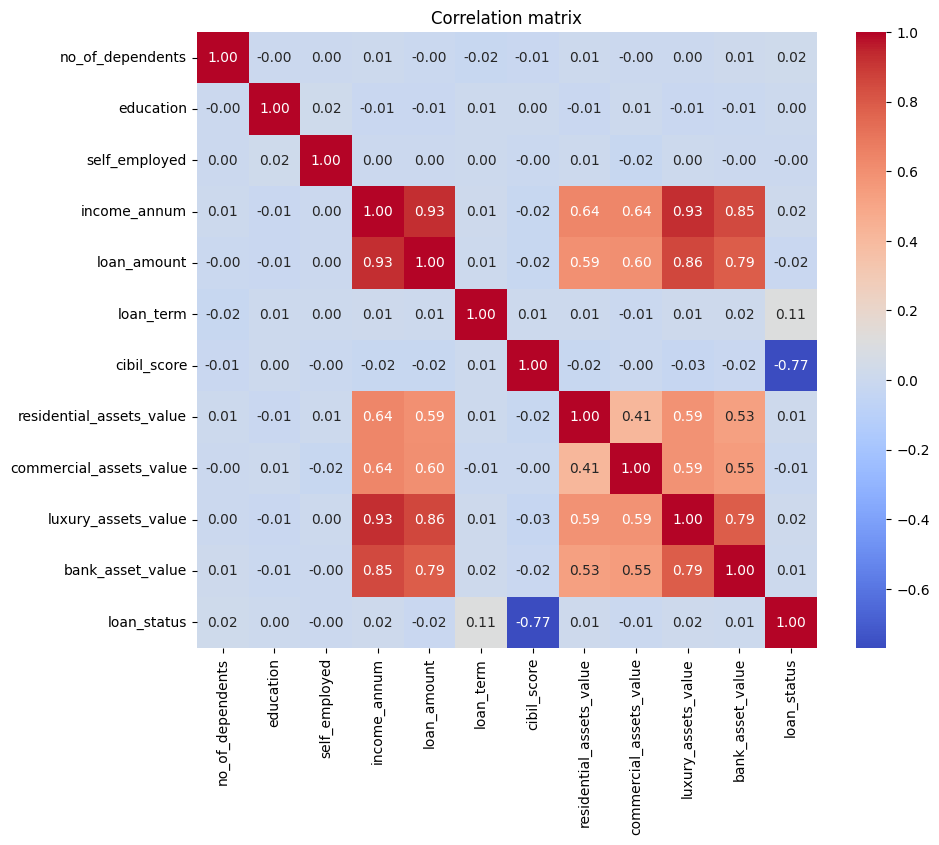

Features dropped due to high correlation: ['loan_amount', 'luxury_assets_value', 'bank_asset_value', 'loan_status']


,no_of_dependents,education,self_employed,income_annum,loan_term,cibil_score,residential_assets_value,commercial_assets_value
0,2,0,0,9600000,12,778,2400000,17600000
1,0,1,1,4100000,8,417,2700000,2200000
2,3,0,0,9100000,20,506,7100000,4500000
3,3,0,0,8200000,8,467,18200000,3300000
4,5,1,1,9800000,20,382,12400000,8200000


In [ ]:
analysis2_df=df

corr_matrix = analysis2_df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation matrix')
plt.show()


correlation_matrix = analysis2_df.corr().abs()
upper_triangle_mask = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape, dtype=bool), k=1))
threshold = 0.7
to_drop = [column for column in upper_triangle_mask.columns if any(upper_triangle_mask[column] > threshold)]
filtered_df = analysis2_df.drop(columns=to_drop)

print("Features dropped due to high correlation:", to_drop)

filtered_df.head()

> **3.   PCA condenses complex data by extracting essential patterns into new components, reducing redundancy and aiding efficient analysis. It simplifies information while retaining critical dataset characteristics.**

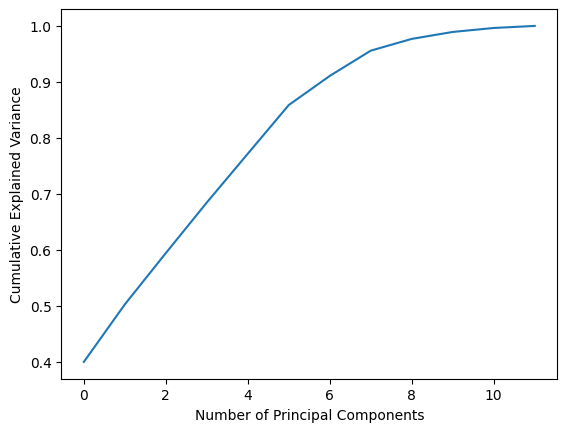

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,loan_status
0,2.922702,-1.232569,0.830458,1.178553,0.138842,0.029089,2.503929,0
1,-1.279552,1.098302,-1.342325,-0.292549,-1.619546,0.420999,0.116247,1
2,3.218276,0.840264,0.303148,1.545397,1.357967,-0.461177,0.210906,1
3,2.481714,0.907908,1.436980,0.518026,-0.037937,0.004553,-1.402466,1
4,2.441534,1.623087,-1.298327,-0.991190,1.763142,-0.372730,0.029391,1


In [ ]:
# x = new_pca_df.drop(columns=['loan_status'])

# pca = PCA()
# df_pca = pca.fit_transform(x)

# explained_variance_ratio = pca.explained_variance_ratio_
# cumulative_explained_variance = np.cumsum(explained_variance_ratio)

# plt.plot(cumulative_explained_variance)
# plt.xlabel('Number of Principal Components')
# plt.ylabel('Cumulative Explained Variance')
# plt.show()

# num_components = 3

# pca = PCA(n_components=num_components)
# df_pca = pca.fit_transform(x)

# columns_pca = [f"PC{i+1}" for i in range(num_components)]
# df_pca = pd.DataFrame(data=df_pca, columns=columns_pca)

# df_pca['loan_status'] = df['loan_status']
data_dir = "/content/loan_approval_dataset.csv"
new_df_PCA = pd.read_csv(data_dir)

new_df_PCA.rename(columns=dict(zip(new_df_PCA.columns,new_df_PCA.columns.str.strip())),inplace=True)

label_encoder = LabelEncoder()

new_df_PCA['education'] = label_encoder.fit_transform(new_df_PCA['education'])
new_df_PCA['self_employed'] = label_encoder.fit_transform(new_df_PCA['self_employed'])
new_df_PCA['loan_status'] = label_encoder.fit_transform(new_df_PCA['loan_status'])

new_df_PCA.drop(['loan_id'], axis = 1, inplace = True)


numerical_columns = new_df_PCA.select_dtypes(include=['float64', 'int64']).columns
if "loan_status" in numerical_columns:
    numerical_columns = numerical_columns.drop("loan_status")

scaler = StandardScaler()
new_df_PCA[numerical_columns] = scaler.fit_transform(new_df_PCA[numerical_columns])
new_df_PCA.head()

pca = PCA()
df_pca = pca.fit_transform(new_df_PCA)

explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

plt.plot(cumulative_explained_variance)
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

num_components = 7

pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(new_df_PCA)

columns_pca = [f"PC{i+1}" for i in range(num_components)]
df_pca = pd.DataFrame(data=df_pca, columns=columns_pca)

df_pca['loan_status'] = df['loan_status']
new_df_clustering_hierarchy =df_pca
new_pca_kmediods=df_pca
df_pca.head()

In [ ]:
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,loan_status
0,2.922702,-1.232569,0.830458,1.178553,0.138842,0.029089,2.503929,0
1,-1.279552,1.098302,-1.342325,-0.292549,-1.619546,0.420999,0.116247,1
2,3.218276,0.840264,0.303148,1.545397,1.357967,-0.461177,0.210906,1
3,2.481714,0.907908,1.436980,0.518026,-0.037937,0.004553,-1.402466,1
4,2.441534,1.623087,-1.298327,-0.991190,1.763142,-0.372730,0.029391,1
...,...,...,...,...,...,...,...,...
4264,-2.948589,1.955914,0.591664,-0.831014,0.655319,-1.479885,-0.089665,1
4265,-1.395035,0.132925,-2.468317,0.690302,-0.188825,-0.120896,0.035236,0
4266,1.368203,0.951498,-0.818195,0.909755,0.852391,1.280886,1.855551,1
4267,-0.534881,-1.221497,-0.179068,0.361246,-0.466919,1.460194,-0.821042,0


# **4. Classification Task:**

In [ ]:
df.head()

,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,2,0,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,0
1,0,1,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,1
2,3,0,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,1
3,3,0,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,1
4,5,1,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,1


In [ ]:
scaler = StandardScaler()

x = df.drop(columns=['loan_status'])
y = df['loan_status']

x = scaler.fit_transform(x)

## **4.1. Classification Task on Original Dataset:**

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [ ]:
model_names = ['Logistic Regression', 'Decision Tree','Random Forest','Support Vector','KNeighbors', 'XGBClassifier']
accuracies = []
precisions = []
recalls = []
f1_scores = []
conf_matrices = []
fprs= []
tprs= []
thresholds= []
aucs= []


### **4.1.1. Training of different Models on Original Dataset:**

> **1.   Logistic Regression Model:**

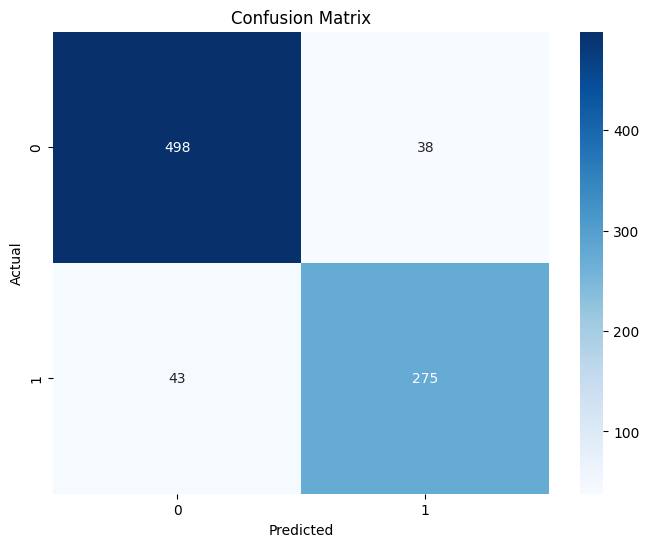

Accuracy: 0.905152224824356
Precision: 0.9049067721845864
Recall: 0.905152224824356
F1 Score: 0.9049966078550483
Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.93      0.92       536
           1       0.88      0.86      0.87       318

    accuracy                           0.91       854
   macro avg       0.90      0.90      0.90       854
weighted avg       0.90      0.91      0.90       854



In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score

logistic_reg = LogisticRegression(random_state=42)

logistic_reg.fit(x_train, y_train)

y_pred = logistic_reg.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

classification_rep = classification_report(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)


fpr, tpr, threshold = roc_curve(y_test, y_pred)

auc = roc_auc_score(y_test, y_pred)

fprs.append(fpr)
tprs.append(tpr)
thresholds.append(threshold)
aucs.append(auc)

accuracies.append(accuracy)
precisions.append(precision)
recalls.append(recall)
f1_scores.append(f1)
conf_matrices.append(conf_matrix)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)


> **2.   Decision Tree Classifier Model:**

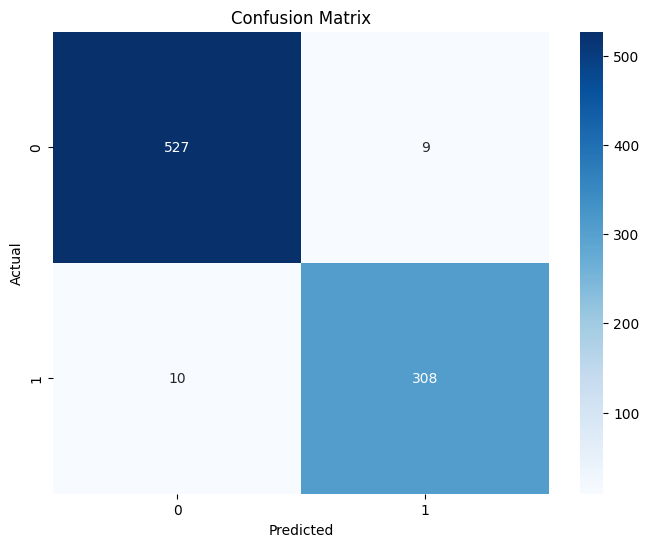

Decision Tree Classifier Metrics:
Accuracy: 0.977751756440281
Precision: 0.9777403171039073
Recall: 0.977751756440281
F1 Score: 0.9777446054465413
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.98      0.98       536
           1       0.97      0.97      0.97       318

    accuracy                           0.98       854
   macro avg       0.98      0.98      0.98       854
weighted avg       0.98      0.98      0.98       854



In [ ]:
decision_tree = DecisionTreeClassifier(random_state=42)

decision_tree.fit(x_train, y_train)

y_pred = decision_tree.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

classification_rep = classification_report(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)

fpr, tpr, threshold = roc_curve(y_test, y_pred)

auc = roc_auc_score(y_test, y_pred)

fprs.append(fpr)
tprs.append(tpr)
thresholds.append(threshold)
aucs.append(auc)

accuracies.append(accuracy)
precisions.append(precision)
recalls.append(recall)
f1_scores.append(f1)
conf_matrices.append(conf_matrix)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("Decision Tree Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **3.   Random Forest Classifier Model:**

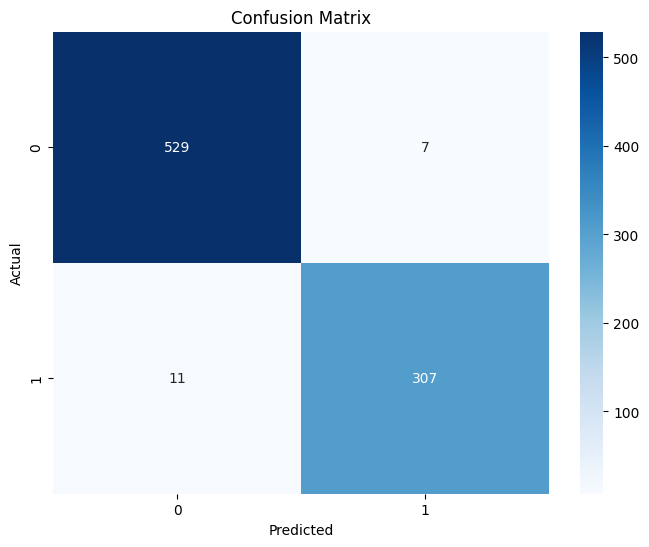

Random Forest Classifier Metrics:
Accuracy: 0.9789227166276346
Precision: 0.9789137113664627
Recall: 0.9789227166276346
F1 Score: 0.9788951934704381
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.99      0.98       536
           1       0.98      0.97      0.97       318

    accuracy                           0.98       854
   macro avg       0.98      0.98      0.98       854
weighted avg       0.98      0.98      0.98       854



In [ ]:
random_forest = RandomForestClassifier(random_state=42)

random_forest.fit(x_train, y_train)

y_pred = random_forest.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

classification_rep = classification_report(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)


fpr, tpr, threshold = roc_curve(y_test, y_pred)

auc = roc_auc_score(y_test, y_pred)

fprs.append(fpr)
tprs.append(tpr)
thresholds.append(threshold)
aucs.append(auc)

accuracies.append(accuracy)
precisions.append(precision)
recalls.append(recall)
f1_scores.append(f1)
conf_matrices.append(conf_matrix)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("Random Forest Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **4.   Support Vector Classification Model (SVC):**

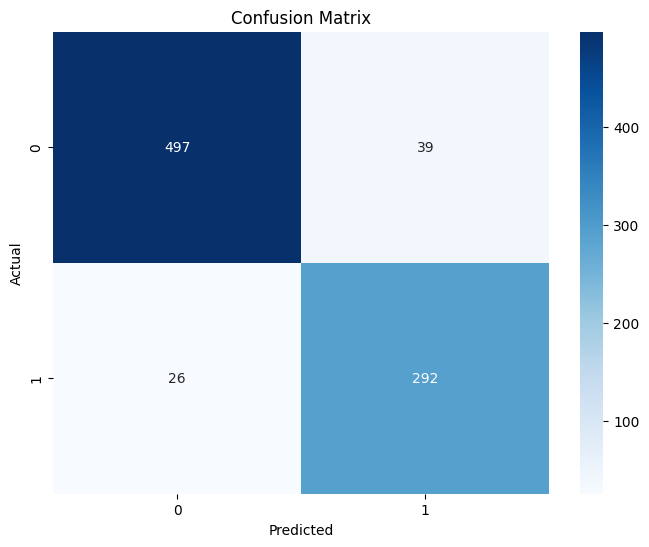

SVM Classifier Metrics:
Accuracy: 0.9238875878220141
Precision: 0.92492441515675
Recall: 0.9238875878220141
F1 Score: 0.9241827169281049
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.93      0.94       536
           1       0.88      0.92      0.90       318

    accuracy                           0.92       854
   macro avg       0.92      0.92      0.92       854
weighted avg       0.92      0.92      0.92       854



In [ ]:
svm_classifier = SVC(random_state=42)

svm_classifier.fit(x_train, y_train)

y_pred = svm_classifier.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

classification_rep = classification_report(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)

fpr, tpr, threshold = roc_curve(y_test, y_pred)

auc = roc_auc_score(y_test, y_pred)

fprs.append(fpr)
tprs.append(tpr)
thresholds.append(threshold)
aucs.append(auc)


accuracies.append(accuracy)
precisions.append(precision)
recalls.append(recall)
f1_scores.append(f1)
conf_matrices.append(conf_matrix)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("SVM Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **5.   KNeighbors Classifier Model (KNN):**

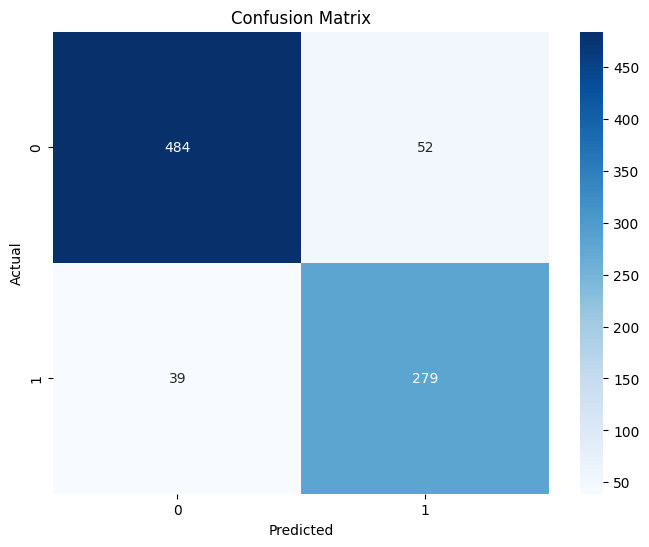

K-Nearest Neighbors Classifier Metrics:
Accuracy: 0.8934426229508197
Precision: 0.8946989330289614
Recall: 0.8934426229508197
F1 Score: 0.8938558036993469
Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.90      0.91       536
           1       0.84      0.88      0.86       318

    accuracy                           0.89       854
   macro avg       0.88      0.89      0.89       854
weighted avg       0.89      0.89      0.89       854



In [ ]:
knn_classifier = KNeighborsClassifier(n_neighbors=5)

knn_classifier.fit(x_train, y_train)

y_pred = knn_classifier.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

classification_rep = classification_report(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)

fpr, tpr, threshold = roc_curve(y_test, y_pred)

auc = roc_auc_score(y_test, y_pred)

fprs.append(fpr)
tprs.append(tpr)
thresholds.append(threshold)
aucs.append(auc)

accuracies.append(accuracy)
precisions.append(precision)
recalls.append(recall)
f1_scores.append(f1)
conf_matrices.append(conf_matrix)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("K-Nearest Neighbors Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **6.   XGBClassifier Model:**

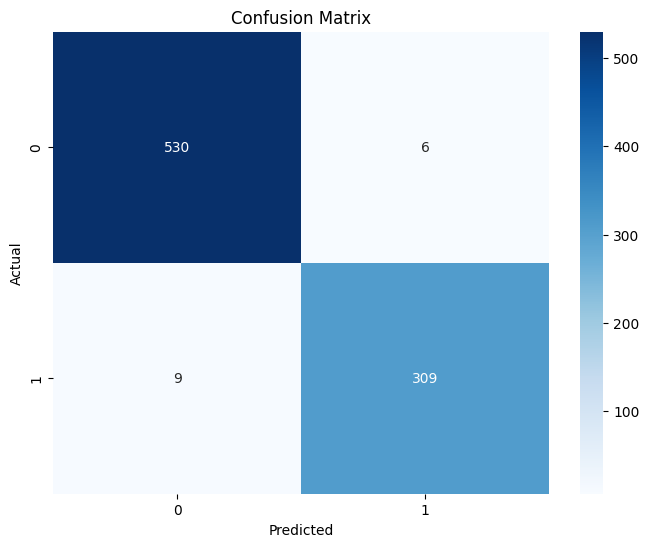

XGBoost Classifier Metrics:
Accuracy: 0.9824355971896955
Precision: 0.9824273418117514
Recall: 0.9824355971896955
F1 Score: 0.982418483851126
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.99      0.99       536
           1       0.98      0.97      0.98       318

    accuracy                           0.98       854
   macro avg       0.98      0.98      0.98       854
weighted avg       0.98      0.98      0.98       854



In [ ]:
xgb_classifier = XGBClassifier(random_state=42)

xgb_classifier.fit(x_train, y_train)

y_pred = xgb_classifier.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

classification_rep = classification_report(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)

accuracies.append(accuracy)
precisions.append(precision)
recalls.append(recall)
f1_scores.append(f1)
conf_matrices.append(conf_matrix)


fpr, tpr, threshold = roc_curve(y_test, y_pred)

auc = roc_auc_score(y_test, y_pred)

fprs.append(fpr)
tprs.append(tpr)
thresholds.append(threshold)
aucs.append(auc)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("XGBoost Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

### **4.1.2. Comparesion between the model performances on Original Dataset:**

In [ ]:
model_comparison = pd.DataFrame({
    'Model': model_names,
    'Accuracy': accuracies,
    'Precision': precisions,
    'Recall': recalls,
    'F1 Score': f1_scores,
    'False Positive Rate' : fprs,
    'True Positive Rate' : tprs,
    'Thresholds': thresholds,
    'AUC': aucs
})

In [ ]:
print(model_comparison)

                 Model  Accuracy  Precision    Recall  F1 Score  \
0  Logistic Regression  0.905152   0.904907  0.905152  0.904997   
1        Decision Tree  0.977752   0.977740  0.977752  0.977745   
2        Random Forest  0.978923   0.978914  0.978923  0.978895   
3       Support Vector  0.923888   0.924924  0.923888  0.924183   
4           KNeighbors  0.893443   0.894699  0.893443  0.893856   
5        XGBClassifier  0.982436   0.982427  0.982436  0.982418   

                False Positive Rate              True Positive Rate  \
0    [0.0, 0.0708955223880597, 1.0]  [0.0, 0.8647798742138365, 1.0]   
1  [0.0, 0.016791044776119403, 1.0]  [0.0, 0.9685534591194969, 1.0]   
2  [0.0, 0.013059701492537313, 1.0]  [0.0, 0.9654088050314465, 1.0]   
3   [0.0, 0.07276119402985075, 1.0]  [0.0, 0.9182389937106918, 1.0]   
4   [0.0, 0.09701492537313433, 1.0]  [0.0, 0.8773584905660378, 1.0]   
5  [0.0, 0.011194029850746268, 1.0]  [0.0, 0.9716981132075472, 1.0]   

  Thresholds       AUC  
0  [2, 

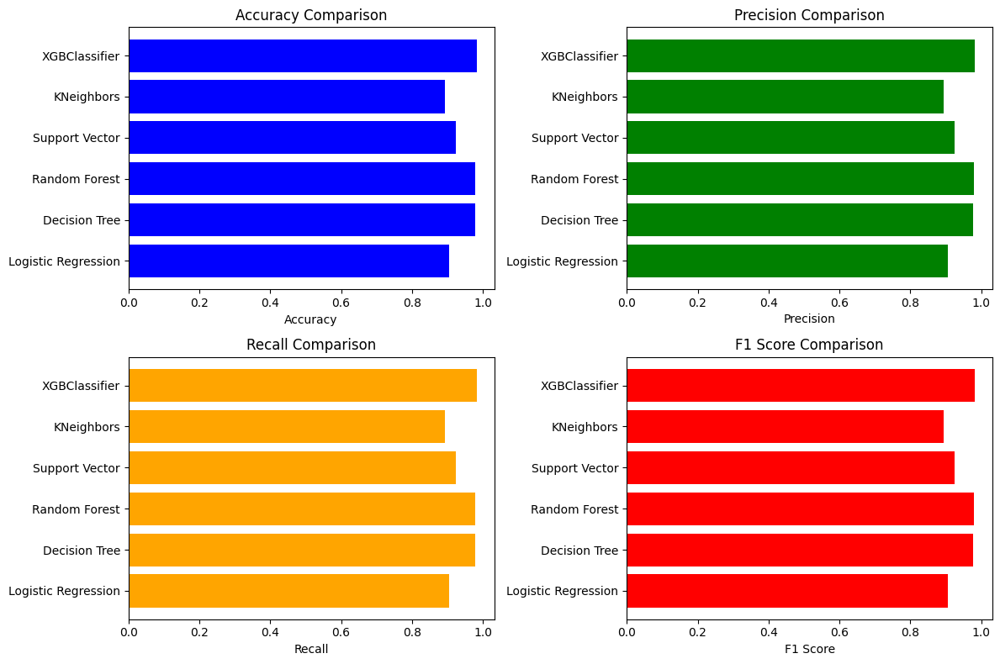

Maximum Accuracy: 0.9824355971896955
Maximum Precision: 0.9824273418117514
Maximum Recall: 0.9824355971896955
Maximum F1 Score: 0.982418483851126


In [ ]:
plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
plt.barh(model_comparison['Model'], model_comparison['Accuracy'], color='blue')
plt.xlabel('Accuracy')
plt.title('Accuracy Comparison')

plt.subplot(2, 2, 2)
plt.barh(model_comparison['Model'], model_comparison['Precision'], color='green')
plt.xlabel('Precision')
plt.title('Precision Comparison')

plt.subplot(2, 2, 3)
plt.barh(model_comparison['Model'], model_comparison['Recall'], color='orange')
plt.xlabel('Recall')
plt.title('Recall Comparison')

plt.subplot(2, 2, 4)
plt.barh(model_comparison['Model'], model_comparison['F1 Score'], color='red')
plt.xlabel('F1 Score')
plt.title('F1 Score Comparison')

plt.tight_layout()
plt.show()

max_accuracy = model_comparison['Accuracy'].max()
max_precision = model_comparison['Precision'].max()
max_recall = model_comparison['Recall'].max()
max_f1_score = model_comparison['F1 Score'].max()

print("Maximum Accuracy:", max_accuracy)
print("Maximum Precision:", max_precision)
print("Maximum Recall:", max_recall)
print("Maximum F1 Score:", max_f1_score)


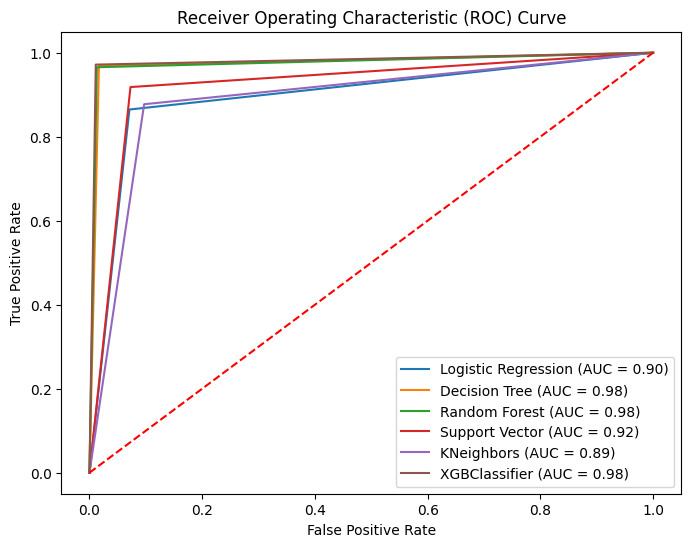

Maximum AUC: 0.9802520416784005


In [ ]:
plt.figure(figsize=(8, 6))
for i in range(len(model_names)):
    plt.plot(fprs[i], tprs[i], label=f'{model_names[i]} (AUC = {aucs[i]:.2f})')

plt.plot([0, 1], [0, 1], 'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

max_auc_score = model_comparison['AUC'].max()

print("Maximum AUC:", max_auc_score)

## **4.2. Classification Task on PCA dataset:**

### **4.2.1. Training of different Models on PCA Dataset:**

In [ ]:
data_dir = "/content/loan_approval_dataset.csv"
new_df = pd.read_csv(data_dir)

new_df.rename(columns=dict(zip(new_df.columns,new_df.columns.str.strip())),inplace=True)

label_encoder = LabelEncoder()

new_df['education'] = label_encoder.fit_transform(new_df['education'])
new_df['self_employed'] = label_encoder.fit_transform(new_df['self_employed'])
new_df['loan_status'] = label_encoder.fit_transform(new_df['loan_status'])

new_df.drop(['loan_id'], axis = 1, inplace = True)


numerical_columns = new_df.select_dtypes(include=['float64', 'int64']).columns
if "loan_status" in numerical_columns:
    numerical_columns = numerical_columns.drop("loan_status")

scaler = StandardScaler()
new_df[numerical_columns] = scaler.fit_transform(new_df[numerical_columns])
new_df.head()


,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,-0.294102,-0.995559,-1.007288,1.617979,1.633052,0.192617,1.032792,-0.780058,2.877289,0.832028,0.930304,0
1,-1.473548,1.004461,0.992765,-0.341750,-0.324414,-0.508091,-1.061051,-0.733924,-0.631921,-0.694993,-0.515936,1
2,0.295621,-0.995559,-1.007288,1.439822,1.610933,1.594031,-0.544840,-0.057300,-0.107818,1.996520,2.407316,1
3,0.295621,-0.995559,-1.007288,1.119139,1.721525,-0.508091,-0.771045,1.649637,-0.381263,0.897943,0.899533,1
4,1.475067,1.004461,0.992765,1.689242,1.002681,1.594031,-1.264055,0.757724,0.735304,1.568075,0.007172,1


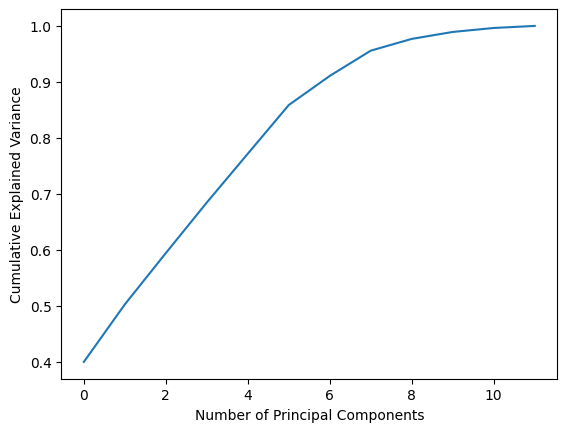

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,loan_status
0,2.922702,-1.232569,0.830458,1.178553,0.138842,0.029089,2.503929,0
1,-1.279552,1.098302,-1.342325,-0.292549,-1.619546,0.420999,0.116247,1
2,3.218276,0.840264,0.303148,1.545397,1.357967,-0.461177,0.210906,1
3,2.481714,0.907908,1.436980,0.518026,-0.037937,0.004553,-1.402466,1
4,2.441534,1.623087,-1.298327,-0.991190,1.763142,-0.372730,0.029391,1


In [ ]:
pca = PCA()
df_pca = pca.fit_transform(new_df)

explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

plt.plot(cumulative_explained_variance)
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

num_components = 7

pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(new_df)

columns_pca = [f"PC{i+1}" for i in range(num_components)]
df_pca = pd.DataFrame(data=df_pca, columns=columns_pca)

df_pca['loan_status'] = new_df['loan_status']
df_pca.head()

In [ ]:
y1 = df_pca['loan_status']
x1 = df_pca.drop(columns=['loan_status'])

In [ ]:
x_train1, x_test1, y_train1, y_test1 = train_test_split(x1, y1, test_size=0.2, random_state=42)

In [ ]:
model_names2 = ['Logistic Regression', 'Decision Tree','Random Forest','Support Vector','KNeighbors', 'XGBClassifier']
accuracies2 = []
precisions2 = []
recalls2 = []
f1_scores2 = []
conf_matrices2 = []
fprs2= []
tprs2= []
thresholds2= []
aucs2= []


> **1.   Logistic Regression Model on PCA:**

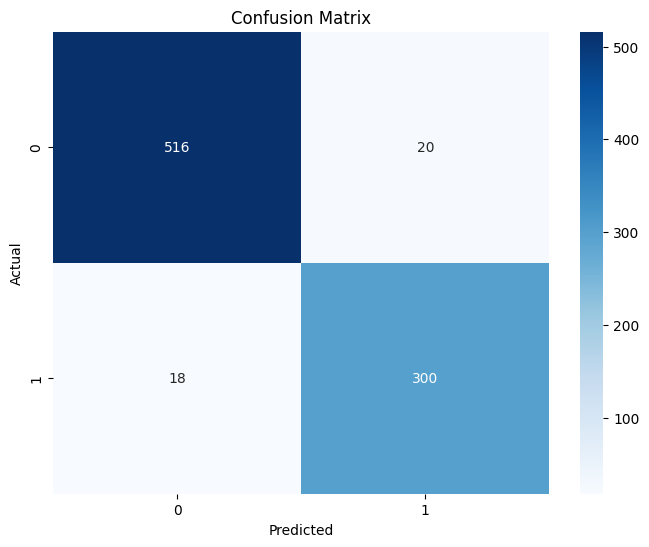

Accuracy: 0.955503512880562
Precision: 0.9555709417677551
Recall: 0.955503512880562
F1 Score: 0.9555316710887998
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.96      0.96       536
           1       0.94      0.94      0.94       318

    accuracy                           0.96       854
   macro avg       0.95      0.95      0.95       854
weighted avg       0.96      0.96      0.96       854



In [ ]:
logistic_reg = LogisticRegression(random_state=42)

logistic_reg.fit(x_train1, y_train1)

y_pred1 = logistic_reg.predict(x_test1)

accuracy = accuracy_score(y_test1, y_pred1)

precision = precision_score(y_test1, y_pred1, average='weighted')
recall = recall_score(y_test1, y_pred1, average='weighted')
f1 = f1_score(y_test1, y_pred1, average='weighted')

classification_rep = classification_report(y_test1, y_pred1)

conf_matrix = confusion_matrix(y_test1, y_pred1)

accuracies2.append(accuracy)
precisions2.append(precision)
recalls2.append(recall)
f1_scores2.append(f1)
conf_matrices2.append(conf_matrix)


fpr, tpr, threshold = roc_curve(y_test1, y_pred1)

auc = roc_auc_score(y_test1, y_pred1)

fprs2.append(fpr)
tprs2.append(tpr)
thresholds2.append(threshold)
aucs2.append(auc)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **2.   Decision Tree Classifier Model on PCA:**

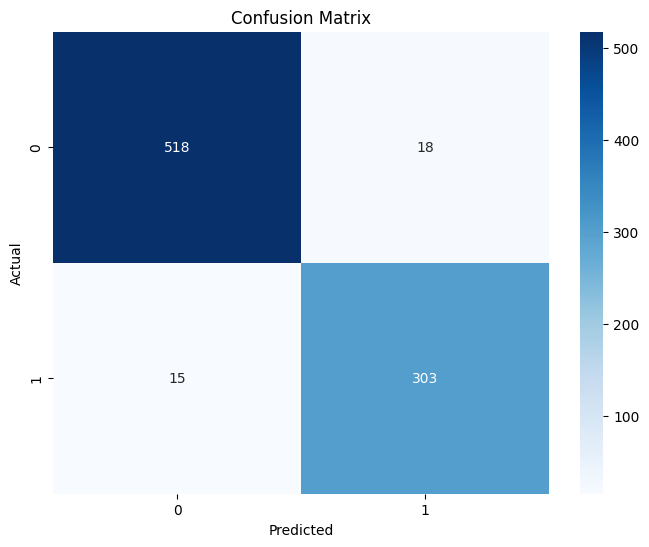

Decision Tree Classifier Metrics:
Accuracy: 0.9613583138173302
Precision: 0.9614564362198019
Recall: 0.9613583138173302
F1 Score: 0.9613948007386743
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.97      0.97       536
           1       0.94      0.95      0.95       318

    accuracy                           0.96       854
   macro avg       0.96      0.96      0.96       854
weighted avg       0.96      0.96      0.96       854



In [ ]:
decision_tree = DecisionTreeClassifier(random_state=42)

decision_tree.fit(x_train1, y_train1)

y_pred1 = decision_tree.predict(x_test1)

accuracy = accuracy_score(y_test1, y_pred1)

precision = precision_score(y_test1, y_pred1, average='weighted')
recall = recall_score(y_test1, y_pred1, average='weighted')
f1 = f1_score(y_test1, y_pred1, average='weighted')

classification_rep = classification_report(y_test1, y_pred1)

conf_matrix = confusion_matrix(y_test1, y_pred1)

accuracies2.append(accuracy)
precisions2.append(precision)
recalls2.append(recall)
f1_scores2.append(f1)
conf_matrices2.append(conf_matrix)

fpr, tpr, threshold = roc_curve(y_test1, y_pred1)

auc = roc_auc_score(y_test1, y_pred1)

fprs2.append(fpr)
tprs2.append(tpr)
thresholds2.append(threshold)
aucs2.append(auc)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("Decision Tree Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **3.   Random Forest Classifier Model on PCA:**

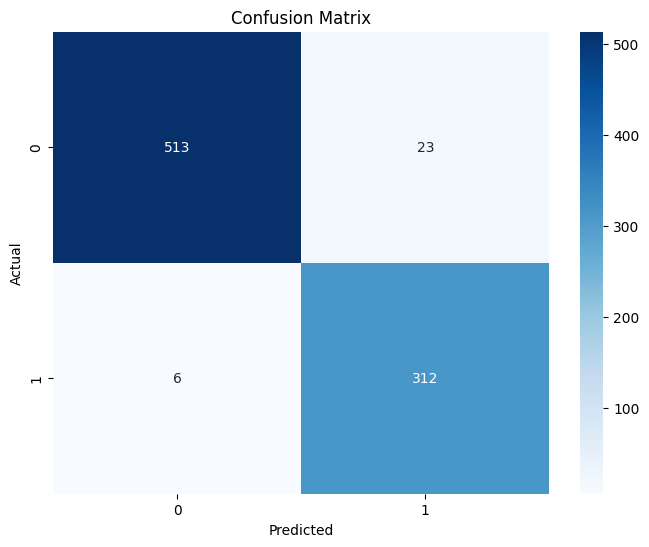

Random Forest Classifier Metrics:
Accuracy: 0.9660421545667447
Precision: 0.9671787264487084
Recall: 0.9660421545667447
F1 Score: 0.966210584573125
Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.96      0.97       536
           1       0.93      0.98      0.96       318

    accuracy                           0.97       854
   macro avg       0.96      0.97      0.96       854
weighted avg       0.97      0.97      0.97       854



In [ ]:
random_forest = RandomForestClassifier(random_state=42)

random_forest.fit(x_train1, y_train1)

y_pred1 = random_forest.predict(x_test1)

accuracy = accuracy_score(y_test1, y_pred1)

precision = precision_score(y_test1, y_pred1, average='weighted')
recall = recall_score(y_test1, y_pred1, average='weighted')
f1 = f1_score(y_test1, y_pred1, average='weighted')

classification_rep = classification_report(y_test1, y_pred1)

conf_matrix = confusion_matrix(y_test1, y_pred1)

accuracies2.append(accuracy)
precisions2.append(precision)
recalls2.append(recall)
f1_scores2.append(f1)
conf_matrices2.append(conf_matrix)

fpr, tpr, threshold = roc_curve(y_test1, y_pred1)

auc = roc_auc_score(y_test1, y_pred1)

fprs2.append(fpr)
tprs2.append(tpr)
thresholds2.append(threshold)
aucs2.append(auc)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("Random Forest Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **4.   Support Vector Classification Model (SVC) on PCA:**

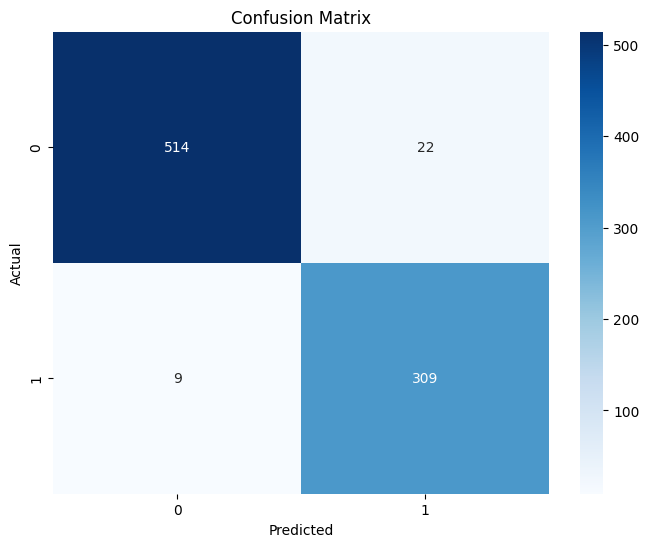

SVM Classifier Metrics:
Accuracy: 0.9637002341920374
Precision: 0.96445004563155
Recall: 0.9637002341920374
F1 Score: 0.9638409880734038
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.96      0.97       536
           1       0.93      0.97      0.95       318

    accuracy                           0.96       854
   macro avg       0.96      0.97      0.96       854
weighted avg       0.96      0.96      0.96       854



In [ ]:
svm_classifier = SVC(random_state=42)

svm_classifier.fit(x_train1, y_train1)

y_pred1 = svm_classifier.predict(x_test1)

accuracy = accuracy_score(y_test1, y_pred1)

precision = precision_score(y_test1, y_pred1, average='weighted')
recall = recall_score(y_test1, y_pred1, average='weighted')
f1 = f1_score(y_test1, y_pred1, average='weighted')

classification_rep = classification_report(y_test1, y_pred1)

conf_matrix = confusion_matrix(y_test1, y_pred1)

accuracies2.append(accuracy)
precisions2.append(precision)
recalls2.append(recall)
f1_scores2.append(f1)
conf_matrices2.append(conf_matrix)

fpr, tpr, threshold = roc_curve(y_test1, y_pred1)

auc = roc_auc_score(y_test1, y_pred1)

fprs2.append(fpr)
tprs2.append(tpr)
thresholds2.append(threshold)
aucs2.append(auc)


plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("SVM Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

> **5.   KNeighbors Classifier Model (KNN) on PCA:**

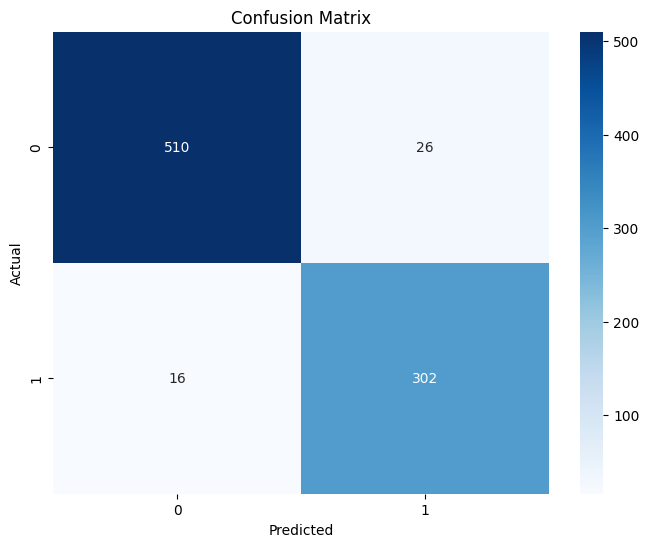

K-Nearest Neighbors Classifier Metrics:
Accuracy: 0.9508196721311475
Precision: 0.9513916866713391
Recall: 0.9508196721311475
F1 Score: 0.9509687790238718
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.95      0.96       536
           1       0.92      0.95      0.93       318

    accuracy                           0.95       854
   macro avg       0.95      0.95      0.95       854
weighted avg       0.95      0.95      0.95       854



In [ ]:
knn_classifier = KNeighborsClassifier(n_neighbors=5)

knn_classifier.fit(x_train1, y_train1)

y_pred1 = knn_classifier.predict(x_test1)

accuracy = accuracy_score(y_test1, y_pred1)

precision = precision_score(y_test1, y_pred1, average='weighted')
recall = recall_score(y_test1, y_pred1, average='weighted')
f1 = f1_score(y_test1, y_pred1, average='weighted')

classification_rep = classification_report(y_test1, y_pred1)

conf_matrix = confusion_matrix(y_test1, y_pred1)

accuracies2.append(accuracy)
precisions2.append(precision)
recalls2.append(recall)
f1_scores2.append(f1)
conf_matrices2.append(conf_matrix)

fpr, tpr, threshold = roc_curve(y_test1, y_pred1)

auc = roc_auc_score(y_test1, y_pred1)

fprs2.append(fpr)
tprs2.append(tpr)
thresholds2.append(threshold)
aucs2.append(auc)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("K-Nearest Neighbors Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


print("Classification Report:\n", classification_rep)

> **6.   XGBClassifier Model on PCA:**

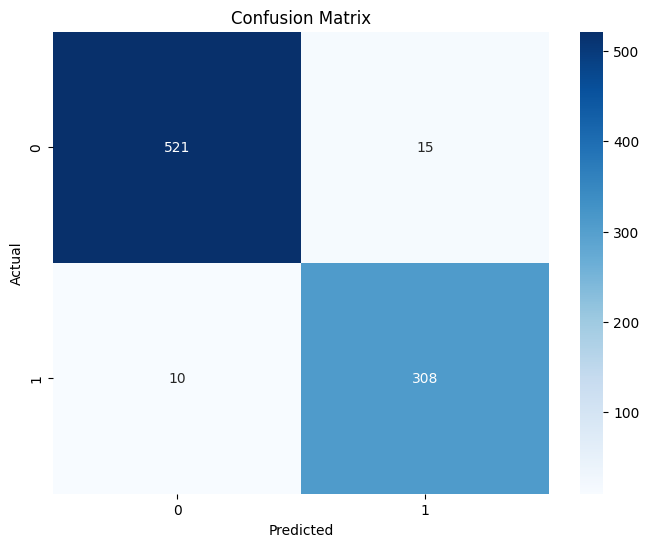

XGBoost Classifier Metrics:
Accuracy: 0.9707259953161592
Precision: 0.9708876301918573
Recall: 0.9707259953161592
F1 Score: 0.9707715789870991
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.97      0.98       536
           1       0.95      0.97      0.96       318

    accuracy                           0.97       854
   macro avg       0.97      0.97      0.97       854
weighted avg       0.97      0.97      0.97       854



In [ ]:
xgb_classifier = XGBClassifier(random_state=42)

xgb_classifier.fit(x_train1, y_train1)

y_pred1 = xgb_classifier.predict(x_test1)

accuracy = accuracy_score(y_test1, y_pred1)

precision = precision_score(y_test1, y_pred1, average='weighted')
recall = recall_score(y_test1, y_pred1, average='weighted')
f1 = f1_score(y_test1, y_pred1, average='weighted')

classification_rep = classification_report(y_test1, y_pred1)

conf_matrix = confusion_matrix(y_test1, y_pred1)

accuracies2.append(accuracy)
precisions2.append(precision)
recalls2.append(recall)
f1_scores2.append(f1)
conf_matrices2.append(conf_matrix)

fpr, tpr, threshold = roc_curve(y_test1, y_pred1)

auc = roc_auc_score(y_test1, y_pred1)

fprs2.append(fpr)
tprs2.append(tpr)
thresholds2.append(threshold)
aucs2.append(auc)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

print("XGBoost Classifier Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

print("Classification Report:\n", classification_rep)

### **4.2.2. Comparesion between the model performances on PCA Dataset:**

In [ ]:
model_comparison2 = pd.DataFrame({
    'Model': model_names2,
    'Accuracy': accuracies2,
    'Precision': precisions2,
    'Recall': recalls2,
    'F1 Score': f1_scores2,
    'False Positive Rate' : fprs2,
    'True Positive Rate' : tprs2,
    'Thresholds': thresholds2,
    'AUC': aucs2
})

In [ ]:
print(model_comparison2)

                 Model  Accuracy  Precision    Recall  F1 Score  \
0  Logistic Regression  0.955504   0.955571  0.955504  0.955532   
1        Decision Tree  0.961358   0.961456  0.961358  0.961395   
2        Random Forest  0.966042   0.967179  0.966042  0.966211   
3       Support Vector  0.963700   0.964450  0.963700  0.963841   
4           KNeighbors  0.950820   0.951392  0.950820  0.950969   
5        XGBClassifier  0.970726   0.970888  0.970726  0.970772   

                False Positive Rate              True Positive Rate  \
0   [0.0, 0.03731343283582089, 1.0]  [0.0, 0.9433962264150944, 1.0]   
1  [0.0, 0.033582089552238806, 1.0]  [0.0, 0.9528301886792453, 1.0]   
2   [0.0, 0.04291044776119403, 1.0]  [0.0, 0.9811320754716981, 1.0]   
3  [0.0, 0.041044776119402986, 1.0]  [0.0, 0.9716981132075472, 1.0]   
4  [0.0, 0.048507462686567165, 1.0]   [0.0, 0.949685534591195, 1.0]   
5  [0.0, 0.027985074626865673, 1.0]  [0.0, 0.9685534591194969, 1.0]   

  Thresholds       AUC  
0  [2, 

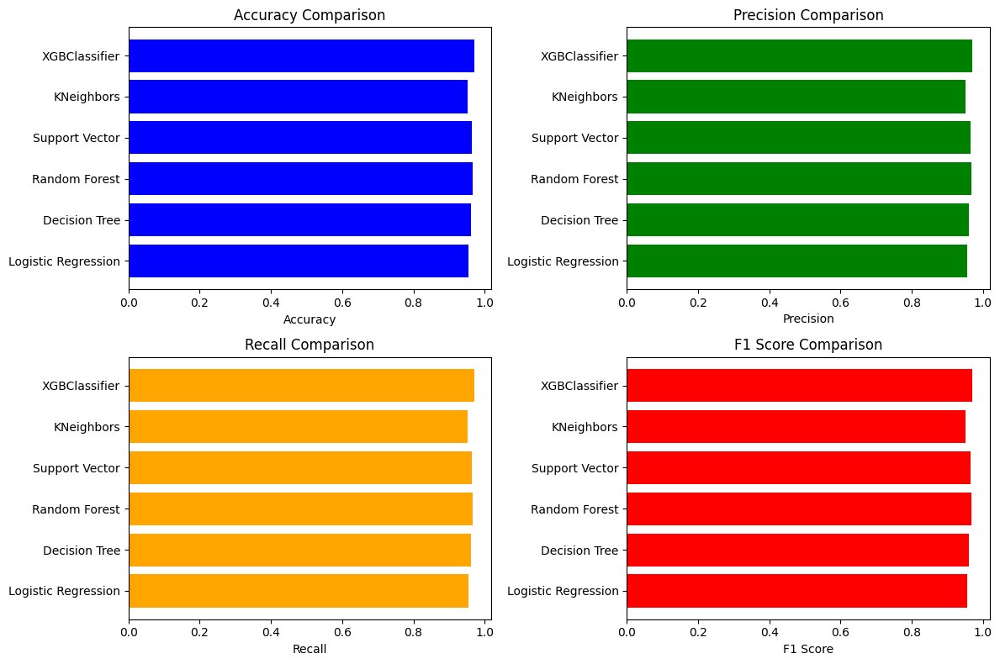

Maximum Accuracy: 0.9707259953161592
Maximum Precision: 0.9708876301918573
Maximum Recall: 0.9707259953161592
Maximum F1 Score: 0.9707715789870991


In [ ]:
plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
plt.barh(model_comparison2['Model'], model_comparison2['Accuracy'], color='blue')
plt.xlabel('Accuracy')
plt.title('Accuracy Comparison')

plt.subplot(2, 2, 2)
plt.barh(model_comparison2['Model'], model_comparison2['Precision'], color='green')
plt.xlabel('Precision')
plt.title('Precision Comparison')

plt.subplot(2, 2, 3)
plt.barh(model_comparison2['Model'], model_comparison2['Recall'], color='orange')
plt.xlabel('Recall')
plt.title('Recall Comparison')

plt.subplot(2, 2, 4)
plt.barh(model_comparison2['Model'], model_comparison2['F1 Score'], color='red')
plt.xlabel('F1 Score')
plt.title('F1 Score Comparison')

plt.tight_layout()
plt.show()

max_accuracy = model_comparison2['Accuracy'].max()
max_precision = model_comparison2['Precision'].max()
max_recall = model_comparison2['Recall'].max()
max_f1_score = model_comparison2['F1 Score'].max()

print("Maximum Accuracy:", max_accuracy)
print("Maximum Precision:", max_precision)
print("Maximum Recall:", max_recall)
print("Maximum F1 Score:", max_f1_score)

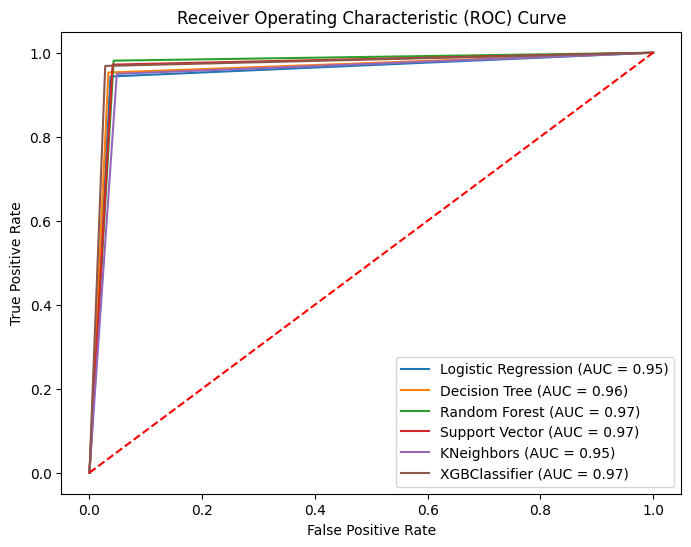

Maximum AUC: 0.9702841922463156


In [ ]:

plt.figure(figsize=(8, 6))
for i in range(len(model_names)):
    plt.plot(fprs2[i], tprs2[i], label=f'{model_names[i]} (AUC = {aucs2[i]:.2f})')

plt.plot([0, 1], [0, 1], 'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

max_auc_score = model_comparison2['AUC'].max()

print("Maximum AUC:", max_auc_score)

# **5.Clustering Task:**

## **5.1. Clustering Task on Original Dataset:**

In [ ]:
clustering_df=df
clustering_df.head()

,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,2,0,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,0
1,0,1,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,1
2,3,0,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,1
3,3,0,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,1
4,5,1,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,1


In [ ]:
data_for_clustering = df

scaler = StandardScaler()
scaled_data = scaler.fit_transform(data_for_clustering)

> **1.   KMeans Clustering:**

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

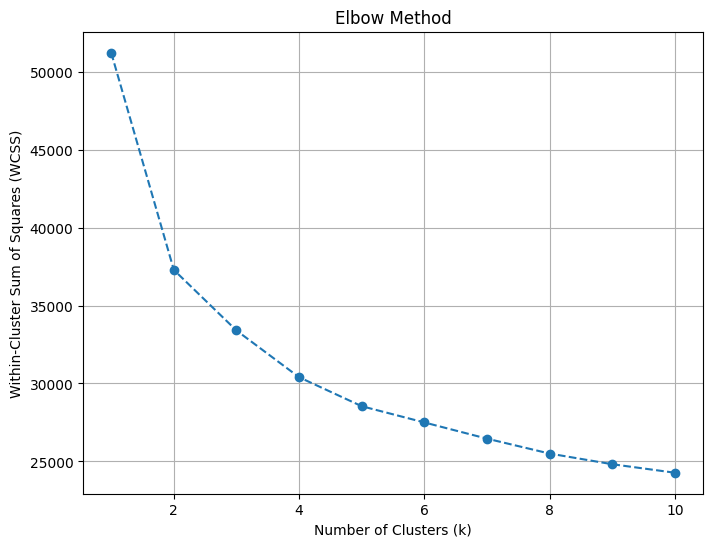

In [ ]:
wcss = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(scaled_data)

    wcss.append(kmeans.inertia_)

plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), wcss, marker='o', linestyle='--')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.grid(True)
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 2, the silhouette score is 0.230


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 3, the silhouette score is 0.176


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 4, the silhouette score is 0.161


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 5, the silhouette score is 0.148


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 6, the silhouette score is 0.142


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 7, the silhouette score is 0.132


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 8, the silhouette score is 0.128


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 9, the silhouette score is 0.129


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 10, the silhouette score is 0.125


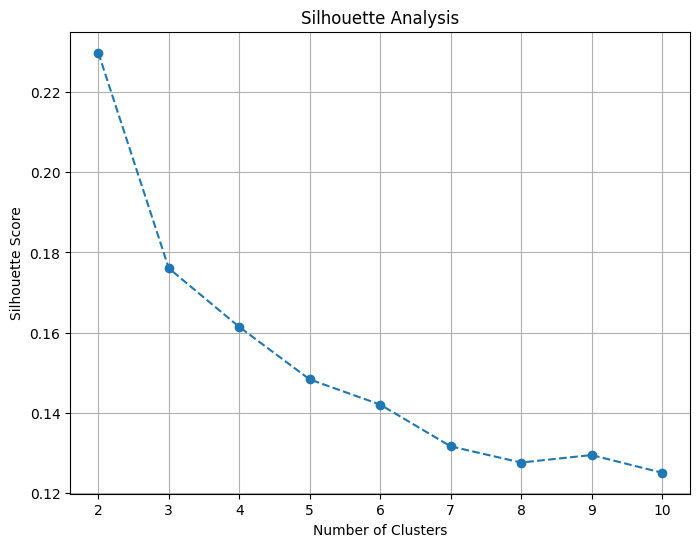

In [ ]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]
silhouette_scores = []

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(scaled_data)

    silhouette_avg = silhouette_score(scaled_data, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    print(f"For n_clusters = {n_clusters}, the silhouette score is {silhouette_avg:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, silhouette_scores, marker='o', linestyle='--')
plt.title('Silhouette Analysis')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

For n_clusters = 2, the Dunn index is 0.132
For n_clusters = 3, the Dunn index is 0.083
For n_clusters = 4, the Dunn index is 0.129
For n_clusters = 5, the Dunn index is 0.102
For n_clusters = 6, the Dunn index is 0.096
For n_clusters = 7, the Dunn index is 0.090
For n_clusters = 8, the Dunn index is 0.111
For n_clusters = 9, the Dunn index is 0.097
For n_clusters = 10, the Dunn index is 0.120


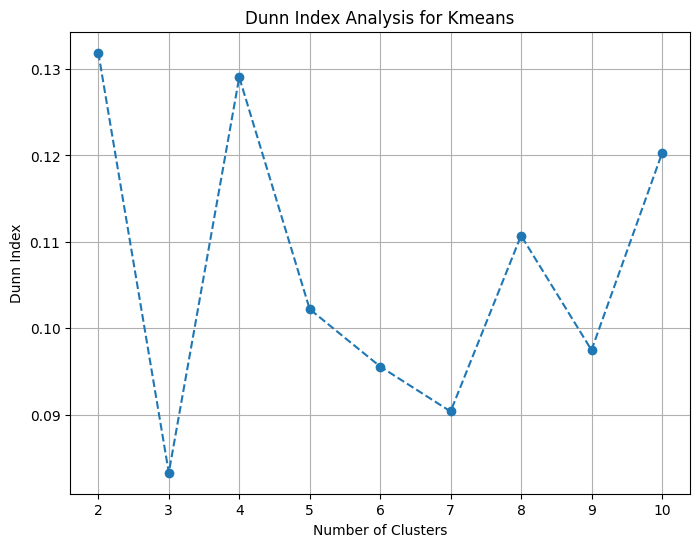

In [ ]:
from pyclustering.cluster.kmeans import kmeans, kmeans_visualizer
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer

def dunn_index(data, clusters):
    cluster_sizes = [len(cluster) for cluster in clusters if len(cluster) > 0]

    if len(cluster_sizes) <= 1:
        return np.nan

    max_diameter = max([np.max(np.linalg.norm(data[cluster_i] - np.mean(data[cluster_i], axis=0), axis=1)) for cluster_i in clusters])

    inter_cluster_distances = []

    for i, cluster_i in enumerate(clusters):
        for j, cluster_j in enumerate(clusters):
            if i != j and len(cluster_i) > 0 and len(cluster_j) > 0:
                distance_matrix = np.linalg.norm(data[cluster_i][:, np.newaxis, :] - data[cluster_j][np.newaxis, :, :], axis=2)
                min_distance = np.min(distance_matrix)
                inter_cluster_distances.append(min_distance)

    if len(inter_cluster_distances) == 0:
        return np.nan

    min_inter_cluster_distance = np.min(inter_cluster_distances)

    return min_inter_cluster_distance / max_diameter

range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]
dunn_scores = []

for n_clusters in range_n_clusters:
    initial_centers = kmeans_plusplus_initializer(scaled_data, n_clusters).initialize()
    kmeans_instance = kmeans(scaled_data, initial_centers)

    kmeans_instance.process()

    clusters = kmeans_instance.get_clusters()

    dunn_score = dunn_index(scaled_data, clusters)
    dunn_scores.append(dunn_score)
    print(f"For n_clusters = {n_clusters}, the Dunn index is {dunn_score:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, dunn_scores, marker='o', linestyle='--')
plt.title('Dunn Index Analysis for Kmeans')
plt.xlabel('Number of Clusters')
plt.ylabel('Dunn Index')
plt.grid(True)
plt.show()

In [ ]:
num_clusters = 3

kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(scaled_data)

df['kmeans_cluster'] = kmeans.labels_

df.head()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status,kmeans_cluster
0,2,0,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,0,0
1,0,1,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,1,2
2,3,0,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,1,0
3,3,0,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,1,0
4,5,1,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,1,0


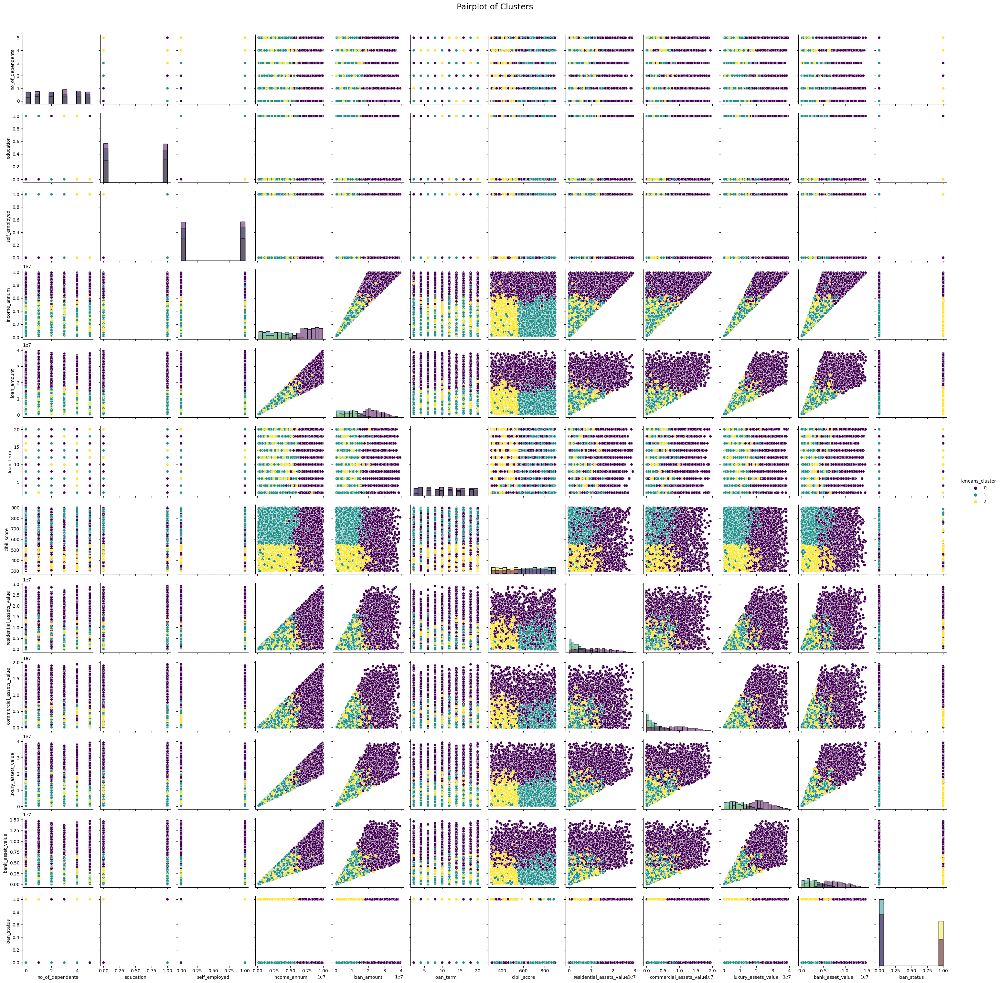

In [ ]:
sns.pairplot(df, hue='kmeans_cluster', palette='viridis', diag_kind='hist', markers='o', height=2.5)
plt.suptitle('Pairplot of Clusters', y=1.02, fontsize=18)
plt.show()

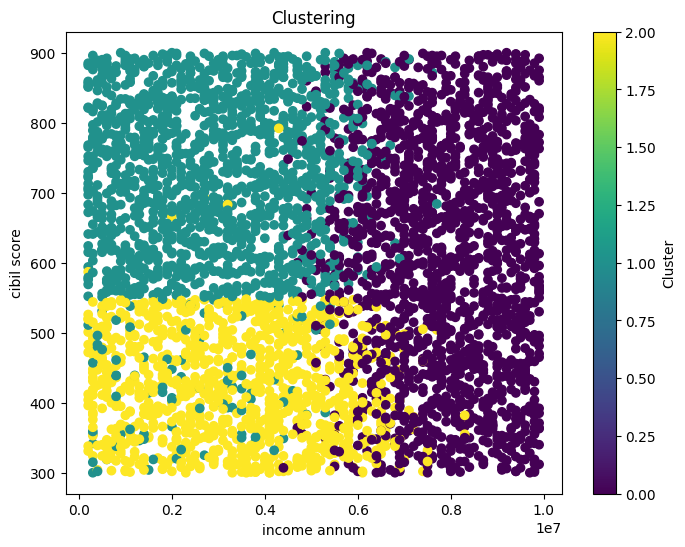

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(df['income_annum'], df['cibil_score'], c=df['kmeans_cluster'], cmap='viridis')
plt.title('Clustering')
plt.xlabel('income annum')
plt.ylabel('cibil score')
plt.colorbar(label='Cluster')
plt.show()


In [ ]:
print(df['kmeans_cluster'].unique())

[0 2 1]


> **2.   Hierarchical Clustering:**

In [ ]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(clustering_df)

model = AgglomerativeClustering(n_clusters=3)
df['hierarchical_cluster'] = model.fit_predict(scaled_data)

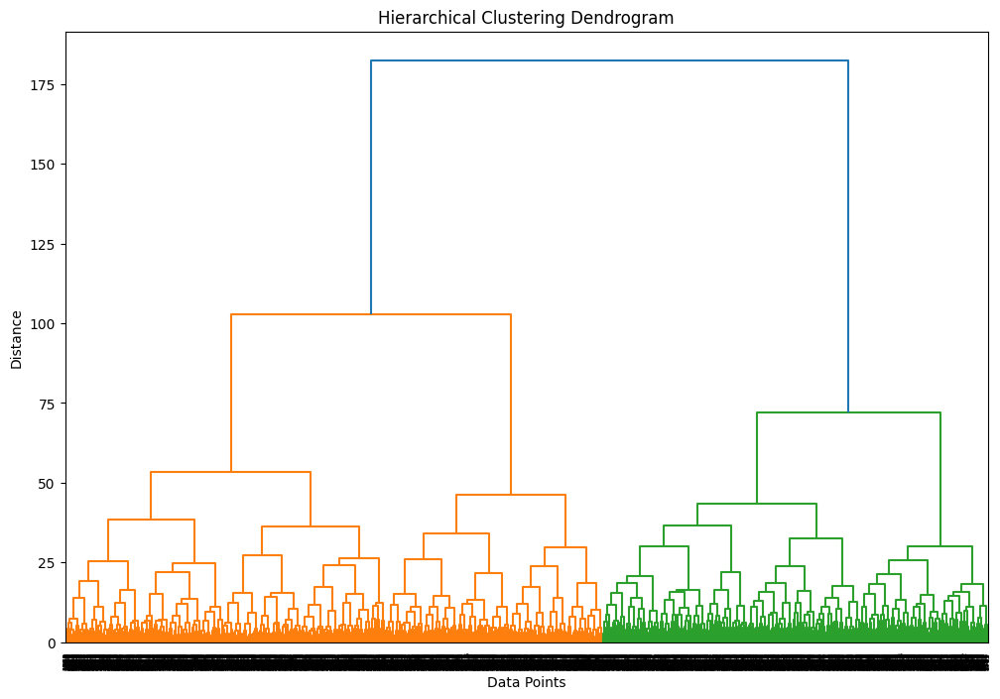

In [ ]:
linked = linkage(scaled_data, method='ward')

plt.figure(figsize=(12, 8))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Data Points')
plt.ylabel('Distance')
plt.show()

For n_clusters = 2, the Dunn index is 0.304
For n_clusters = 3, the Dunn index is 0.304
For n_clusters = 4, the Dunn index is 0.283
For n_clusters = 5, the Dunn index is 0.224
For n_clusters = 6, the Dunn index is 0.138
For n_clusters = 7, the Dunn index is 0.144
For n_clusters = 8, the Dunn index is 0.144
For n_clusters = 9, the Dunn index is 0.144
For n_clusters = 10, the Dunn index is 0.144


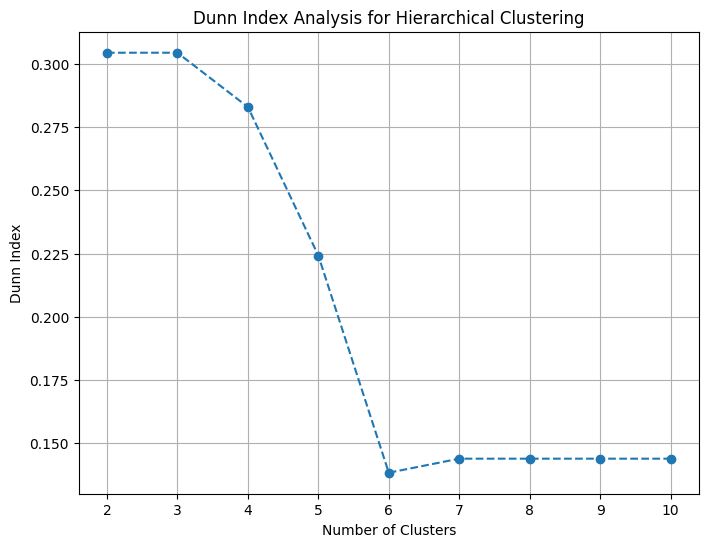

In [ ]:
def dunn_index_hierarchical(data, clusters):
    unique_clusters = np.unique(clusters)

    cluster_indices = [np.where(clusters == cluster)[0] for cluster in unique_clusters]

    cluster_sizes = [len(cluster) for cluster in cluster_indices if len(cluster) > 0]

    if len(cluster_sizes) <= 1:
        return np.nan

    max_diameter = max([np.max(np.linalg.norm(data[cluster_i] - np.mean(data[cluster_i], axis=0), axis=1)) for cluster_i in cluster_indices])

    inter_cluster_distances = []

    for i, cluster_i in enumerate(cluster_indices):
        for j, cluster_j in enumerate(cluster_indices):
            if i != j and len(cluster_i) > 0 and len(cluster_j) > 0:
                distance_matrix = np.linalg.norm(data[cluster_i][:, np.newaxis, :] - data[cluster_j][np.newaxis, :, :], axis=2)
                min_distance = np.min(distance_matrix)
                inter_cluster_distances.append(min_distance)

    if len(inter_cluster_distances) == 0:
        return np.nan

    min_inter_cluster_distance = np.min(inter_cluster_distances)

    return min_inter_cluster_distance / max_diameter

scaler = StandardScaler()
scaled_data = scaler.fit_transform(clustering_df)

linked = linkage(scaled_data, method='ward')

range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]
dunn_scores = []

for n_clusters in range_n_clusters:
    clusters = fcluster(linked, t=n_clusters, criterion='maxclust')

    dunn_score = dunn_index_hierarchical(scaled_data, clusters)
    dunn_scores.append(dunn_score)
    print(f"For n_clusters = {n_clusters}, the Dunn index is {dunn_score:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, dunn_scores, marker='o', linestyle='--')
plt.title('Dunn Index Analysis for Hierarchical Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Dunn Index')
plt.grid(True)
plt.show()

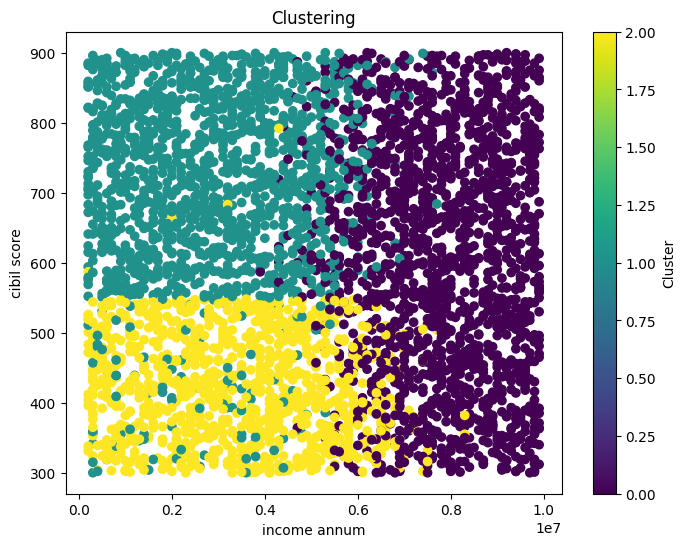

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(df['income_annum'], df['cibil_score'], c=df['hierarchical_cluster'], cmap='viridis')
plt.title('Clustering')
plt.xlabel('income annum')
plt.ylabel('cibil score')
plt.colorbar(label='Cluster')
plt.show()


In [ ]:
df.head()

,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status,kmeans_cluster,hierarchical_cluster
0,2,0,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,0,0,0
1,0,1,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,1,2,2
2,3,0,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,1,0,0
3,3,0,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,1,0,0
4,5,1,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,1,0,0


> **3.   Kmedoids Clustering:**

In [ ]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data_for_clustering)

num_clusters = 3
kmedoids = KMedoids(n_clusters=num_clusters, random_state=42)

kmedoids.fit(scaled_data)

cluster_labels = kmedoids.labels_

df['kmedoids_cluster'] = cluster_labels

For n_clusters = 2, the Dunn index is 0.088
For n_clusters = 3, the Dunn index is 0.037
For n_clusters = 4, the Dunn index is 0.050
For n_clusters = 5, the Dunn index is 0.038
For n_clusters = 6, the Dunn index is 0.044
For n_clusters = 7, the Dunn index is 0.042
For n_clusters = 8, the Dunn index is 0.022
For n_clusters = 9, the Dunn index is 0.043
For n_clusters = 10, the Dunn index is 0.043


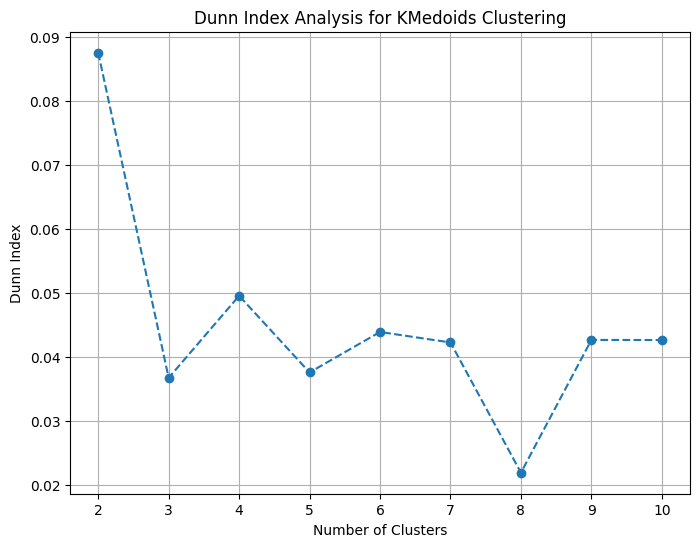

In [ ]:
def dunn_index_kmedoids(data, clusters):
    cluster_indices = [np.where(clusters == cluster)[0] for cluster in np.unique(clusters)]

    max_diameter = max([np.max(pairwise_distances(data[cluster_i])) for cluster_i in cluster_indices])

    inter_cluster_distances = []

    for i, cluster_i in enumerate(cluster_indices):
        for j, cluster_j in enumerate(cluster_indices):
            if i != j and len(cluster_i) > 0 and len(cluster_j) > 0:
                distance_matrix = pairwise_distances(data[cluster_i], data[cluster_j])
                min_distance = np.min(distance_matrix)
                inter_cluster_distances.append(min_distance)

    if len(inter_cluster_distances) == 0:
        return np.nan

    min_inter_cluster_distance = np.min(inter_cluster_distances)

    return min_inter_cluster_distance / max_diameter
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data_for_clustering)

range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]
dunn_scores = []

for n_clusters in range_n_clusters:
    kmedoids = KMedoids(n_clusters=n_clusters, random_state=42)

    clusters = kmedoids.fit_predict(scaled_data)

    dunn_score = dunn_index_kmedoids(scaled_data, clusters)
    dunn_scores.append(dunn_score)
    print(f"For n_clusters = {n_clusters}, the Dunn index is {dunn_score:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, dunn_scores, marker='o', linestyle='--')
plt.title('Dunn Index Analysis for KMedoids Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Dunn Index')
plt.grid(True)
plt.show()



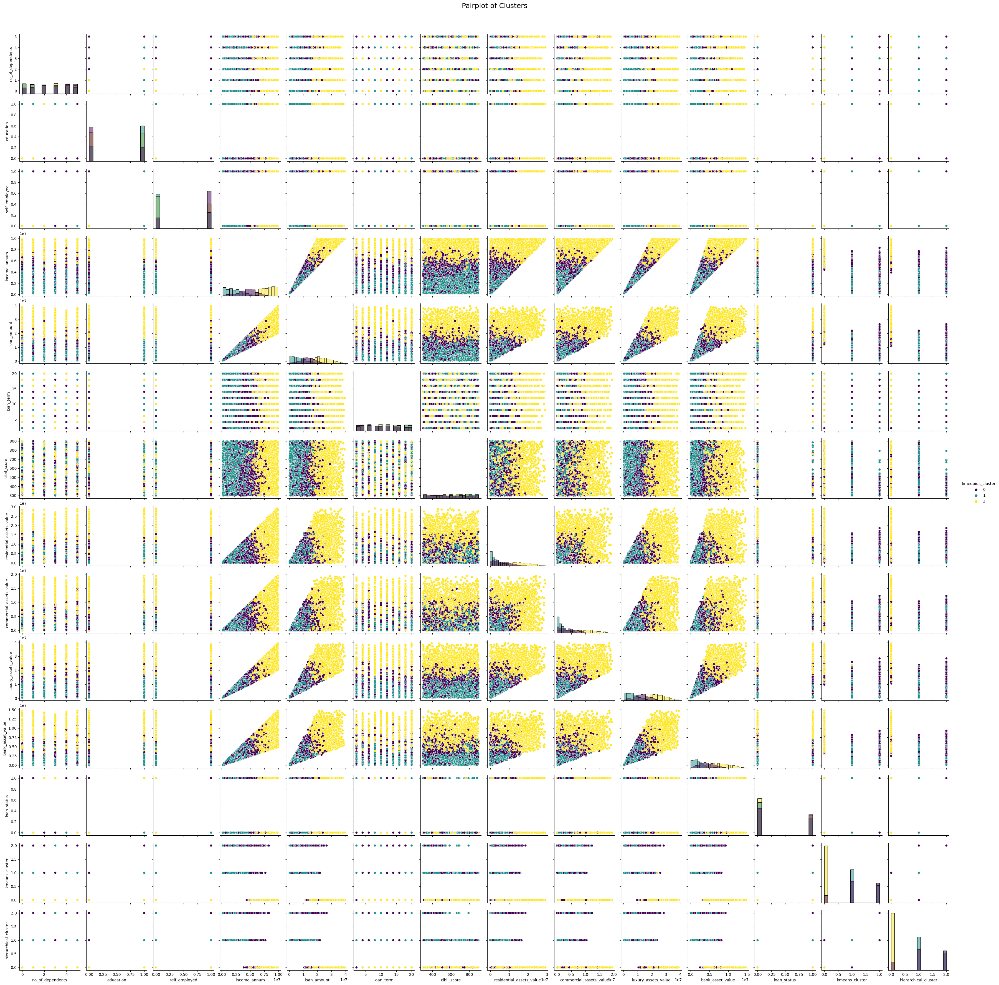

In [ ]:
sns.pairplot(df, hue='kmedoids_cluster', palette='viridis', diag_kind='hist', markers='o', height=2.5)
plt.suptitle('Pairplot of Clusters', y=1.02, fontsize=18)
plt.show()

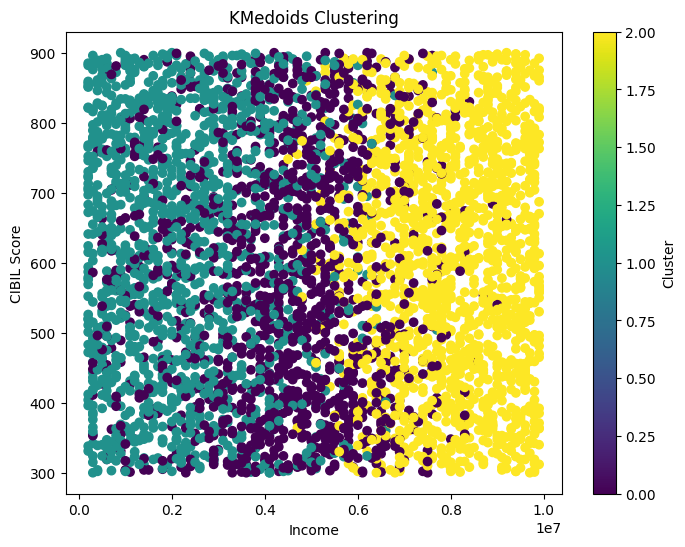

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(df['income_annum'], df['cibil_score'], c=df['kmedoids_cluster'], cmap='viridis')
plt.title('KMedoids Clustering')
plt.xlabel('Income')
plt.ylabel('CIBIL Score')
plt.colorbar(label='Cluster')
plt.show()

## **5.2. Clustering Task on PCA Dataset:**

 > ### ***Scalling and Defining the number of clusters:***

In [ ]:
data_dir = "/content/loan_approval_dataset.csv"
new_df_clustering = pd.read_csv(data_dir)

new_df_clustering.rename(columns=dict(zip(new_df_clustering.columns,new_df_clustering.columns.str.strip())),inplace=True)

label_encoder = LabelEncoder()

new_df_clustering['education'] = label_encoder.fit_transform(new_df_clustering['education'])
new_df_clustering['self_employed'] = label_encoder.fit_transform(new_df_clustering['self_employed'])
new_df_clustering['loan_status'] = label_encoder.fit_transform(new_df_clustering['loan_status'])

new_df_clustering.drop(['loan_id'], axis = 1, inplace = True)


numerical_columns = new_df_clustering.select_dtypes(include=['float64', 'int64']).columns
if "loan_status" in numerical_columns:
    numerical_columns = numerical_columns.drop("loan_status")

scaler = StandardScaler()
new_df_clustering[numerical_columns] = scaler.fit_transform(new_df_clustering[numerical_columns])
new_df_clustering.head()


,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,-0.294102,-0.995559,-1.007288,1.617979,1.633052,0.192617,1.032792,-0.780058,2.877289,0.832028,0.930304,0
1,-1.473548,1.004461,0.992765,-0.341750,-0.324414,-0.508091,-1.061051,-0.733924,-0.631921,-0.694993,-0.515936,1
2,0.295621,-0.995559,-1.007288,1.439822,1.610933,1.594031,-0.544840,-0.057300,-0.107818,1.996520,2.407316,1
3,0.295621,-0.995559,-1.007288,1.119139,1.721525,-0.508091,-0.771045,1.649637,-0.381263,0.897943,0.899533,1
4,1.475067,1.004461,0.992765,1.689242,1.002681,1.594031,-1.264055,0.757724,0.735304,1.568075,0.007172,1


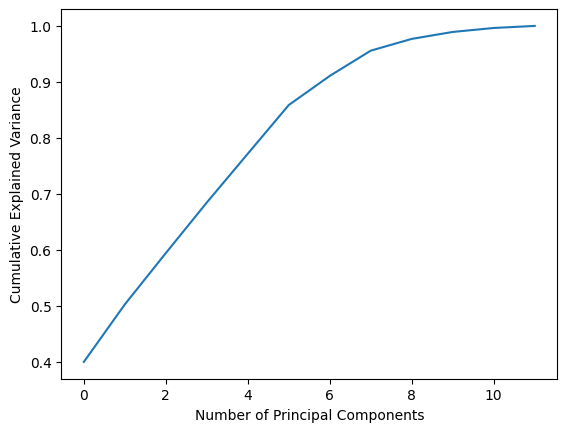

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,loan_status
0,2.922702,-1.232569,0.830458,1.178553,0.138842,0.029089,2.503929,0
1,-1.279552,1.098302,-1.342325,-0.292549,-1.619546,0.420999,0.116247,1
2,3.218276,0.840264,0.303148,1.545397,1.357967,-0.461177,0.210906,1
3,2.481714,0.907908,1.436980,0.518026,-0.037937,0.004553,-1.402466,1
4,2.441534,1.623087,-1.298327,-0.991190,1.763142,-0.372730,0.029391,1


In [ ]:
pca = PCA()
df_pca = pca.fit_transform(new_df_clustering)

explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

plt.plot(cumulative_explained_variance)
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

num_components = 7

pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(new_df)

columns_pca = [f"PC{i+1}" for i in range(num_components)]
df_pca = pd.DataFrame(data=df_pca, columns=columns_pca)

df_pca['loan_status'] = new_df['loan_status']
new_df_clustering_hierarchy =df_pca
new_pca_kmediods=df_pca
df_pca.head()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

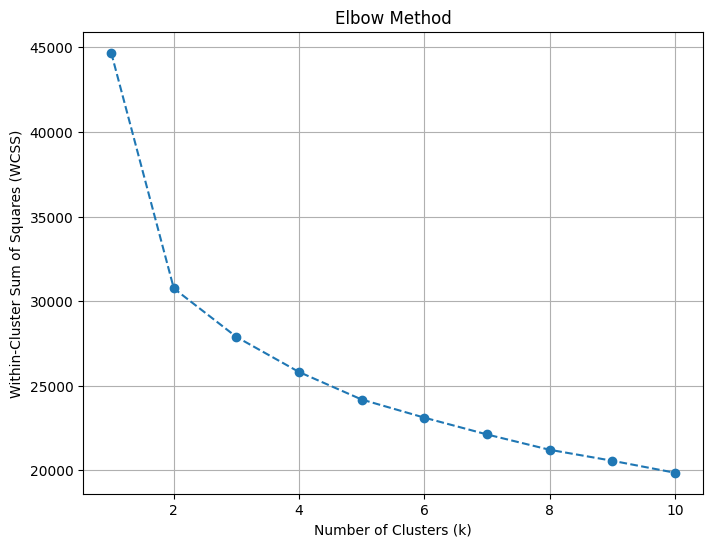

In [ ]:
wcss = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(df_pca)
    wcss.append(kmeans.inertia_)

plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), wcss, marker='o', linestyle='--')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.grid(True)
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 2, the silhouette score is 0.258


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 3, the silhouette score is 0.149


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 4, the silhouette score is 0.146


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 5, the silhouette score is 0.139


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 6, the silhouette score is 0.127


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 7, the silhouette score is 0.130


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 8, the silhouette score is 0.129


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 9, the silhouette score is 0.140


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 10, the silhouette score is 0.135


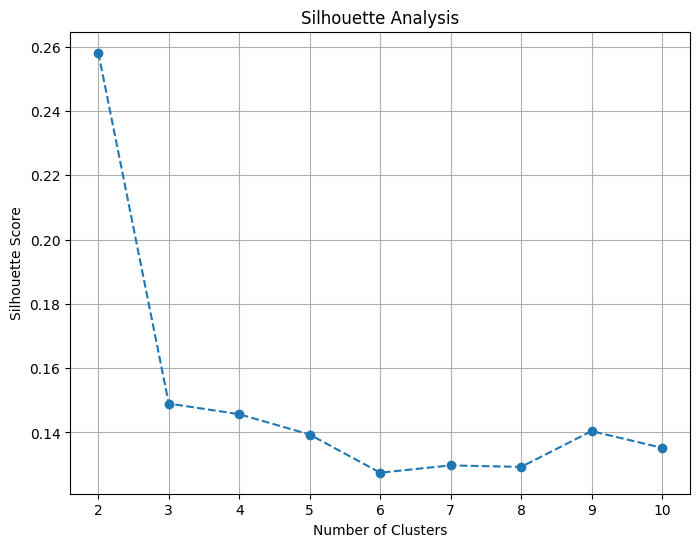

In [ ]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]
silhouette_scores = []

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(df_pca)

    silhouette_avg = silhouette_score(df_pca, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    print(f"For n_clusters = {n_clusters}, the silhouette score is {silhouette_avg:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, silhouette_scores, marker='o', linestyle='--')
plt.title('Silhouette Analysis')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

> **1.   KMeans Clustering on PCA:**

In [ ]:
num_clusters = 2

kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(df_pca)

df_pca['kmeans_cluster'] = kmeans.labels_

df_pca.head()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,loan_status,kmeans_cluster
0,2.922702,-1.232569,0.830458,1.178553,0.138842,0.029089,2.503929,0,0
1,-1.279552,1.098302,-1.342325,-0.292549,-1.619546,0.420999,0.116247,1,1
2,3.218276,0.840264,0.303148,1.545397,1.357967,-0.461177,0.210906,1,0
3,2.481714,0.907908,1.436980,0.518026,-0.037937,0.004553,-1.402466,1,0
4,2.441534,1.623087,-1.298327,-0.991190,1.763142,-0.372730,0.029391,1,0


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 2, the Dunn index is 0.188


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 3, the Dunn index is 0.297


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 4, the Dunn index is 0.128


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 5, the Dunn index is 0.066


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 6, the Dunn index is 0.083


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 7, the Dunn index is 0.062


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 8, the Dunn index is 0.066


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 9, the Dunn index is 0.067


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 10, the Dunn index is 0.068


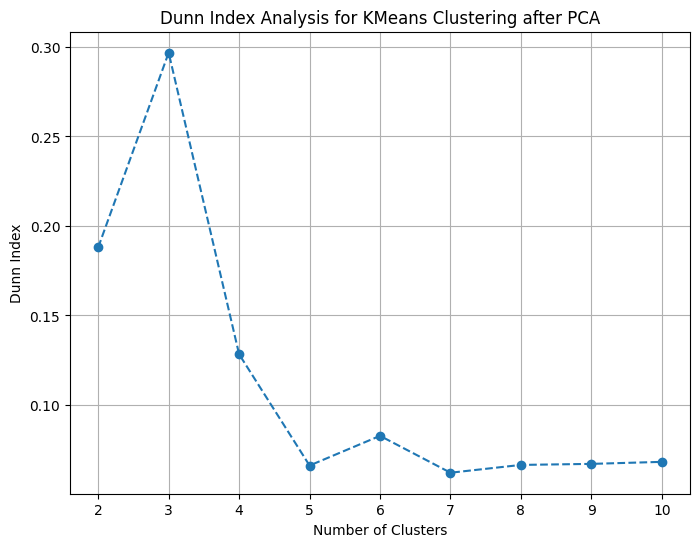

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

def dunn_index_kmeans_pca(data, clusters):
    unique_clusters = np.unique(clusters)

    cluster_indices = [np.where(clusters == cluster)[0] for cluster in unique_clusters]

    cluster_sizes = [len(cluster) for cluster in cluster_indices if len(cluster) > 0]

    if len(cluster_sizes) <= 1:
        return np.nan

    max_diameter = max([np.max(np.linalg.norm(data[cluster_i] - np.mean(data[cluster_i], axis=0), axis=1)) for cluster_i in cluster_indices])

    inter_cluster_distances = []

    for i, cluster_i in enumerate(cluster_indices):
        for j, cluster_j in enumerate(cluster_indices):
            if i != j and len(cluster_i) > 0 and len(cluster_j) > 0:
                distance_matrix = np.linalg.norm(data[cluster_i][:, np.newaxis, :] - data[cluster_j][np.newaxis, :, :], axis=2)
                min_distance = np.min(distance_matrix)
                inter_cluster_distances.append(min_distance)

    if len(inter_cluster_distances) == 0:
        return np.nan

    min_inter_cluster_distance = np.min(inter_cluster_distances)

    return min_inter_cluster_distance / max_diameter

scaler_pca_kmeans = StandardScaler()
scaled_data_pca_kmeans = scaler_pca_kmeans.fit_transform(df_pca.drop('kmeans_cluster', axis=1))

range_n_clusters_pca_kmeans = [2, 3, 4, 5, 6, 7, 8, 9, 10]
dunn_scores_pca_kmeans = []

for n_clusters_pca_kmeans in range_n_clusters_pca_kmeans:
    kmeans_pca = KMeans(n_clusters=n_clusters_pca_kmeans, init='k-means++', random_state=42)

    kmeans_pca.fit(scaled_data_pca_kmeans)

    clusters_pca_kmeans = kmeans_pca.labels_

    dunn_score_pca_kmeans = dunn_index_kmeans_pca(scaled_data_pca_kmeans, clusters_pca_kmeans)
    dunn_scores_pca_kmeans.append(dunn_score_pca_kmeans)
    print(f"For n_clusters = {n_clusters_pca_kmeans}, the Dunn index is {dunn_score_pca_kmeans:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters_pca_kmeans, dunn_scores_pca_kmeans, marker='o', linestyle='--')
plt.title('Dunn Index Analysis for KMeans Clustering after PCA')
plt.xlabel('Number of Clusters')
plt.ylabel('Dunn Index')
plt.grid(True)
plt.show()


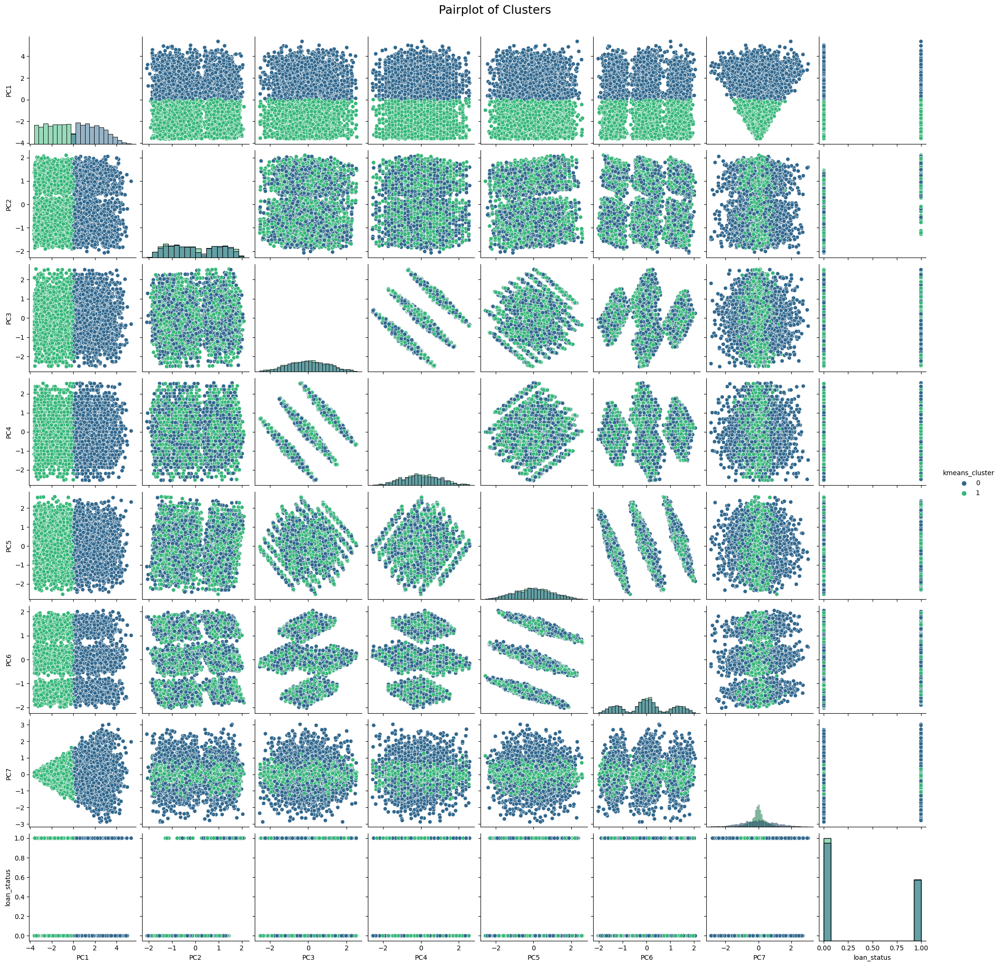

In [ ]:
sns.pairplot(df_pca, hue='kmeans_cluster', palette='viridis', diag_kind='hist', markers='o', height=2.5)
plt.suptitle('Pairplot of Clusters', y=1.02, fontsize=18)
plt.show()

> **2.   Hierarchical Clustering:**

In [ ]:
model = AgglomerativeClustering(n_clusters=2)
df_pca['hierarchical_cluster'] = model.fit_predict(new_df_clustering_hierarchy)

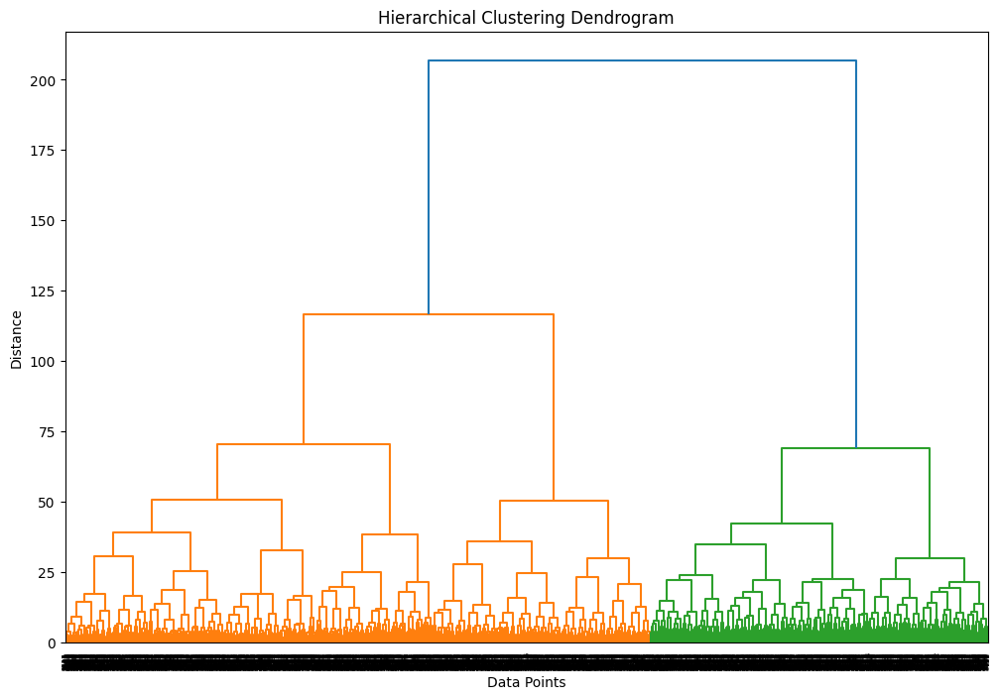

In [ ]:
linked = linkage(scaled_data, method='ward')

plt.figure(figsize=(12, 8))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Data Points')
plt.ylabel('Distance')
plt.show()

For n_clusters = 2, the Dunn index is 0.406
For n_clusters = 3, the Dunn index is 0.290
For n_clusters = 4, the Dunn index is 0.307
For n_clusters = 5, the Dunn index is 0.307
For n_clusters = 6, the Dunn index is 0.256
For n_clusters = 7, the Dunn index is 0.256
For n_clusters = 8, the Dunn index is 0.256
For n_clusters = 9, the Dunn index is 0.131
For n_clusters = 10, the Dunn index is 0.131


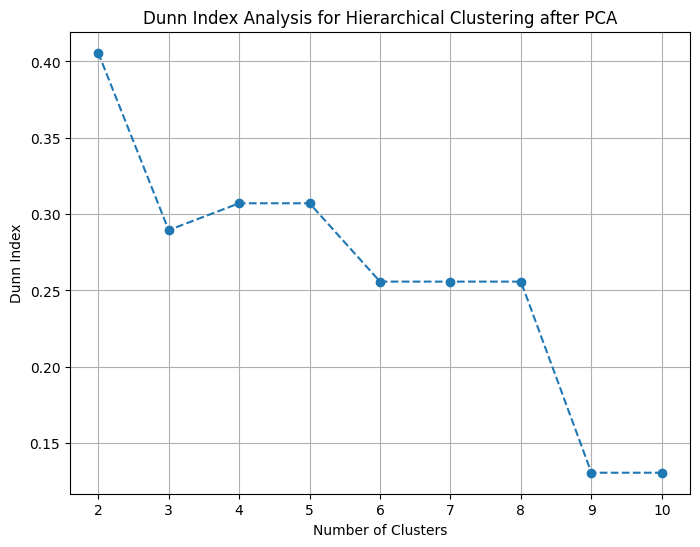

In [ ]:
def dunn_index_hierarchical_pca(data, clusters):
    unique_clusters = np.unique(clusters)

    cluster_indices = [np.where(clusters == cluster)[0] for cluster in unique_clusters]

    cluster_sizes = [len(cluster) for cluster in cluster_indices if len(cluster) > 0]

    if len(cluster_sizes) <= 1:
        return np.nan

    max_diameter = max([np.max(np.linalg.norm(data[cluster_i] - np.mean(data[cluster_i], axis=0), axis=1)) for cluster_i in cluster_indices])

    inter_cluster_distances = []

    for i, cluster_i in enumerate(cluster_indices):
        for j, cluster_j in enumerate(cluster_indices):
            if i != j and len(cluster_i) > 0 and len(cluster_j) > 0:
                distance_matrix = np.linalg.norm(data[cluster_i][:, np.newaxis, :] - data[cluster_j][np.newaxis, :, :], axis=2)
                min_distance = np.min(distance_matrix)
                inter_cluster_distances.append(min_distance)

    if len(inter_cluster_distances) == 0:
        return np.nan

    min_inter_cluster_distance = np.min(inter_cluster_distances)

    return min_inter_cluster_distance / max_diameter

scaler_pca = StandardScaler()
scaled_data_pca = scaler_pca.fit_transform(new_df_clustering_hierarchy)

linked_pca = linkage(scaled_data_pca, method='ward')

range_n_clusters_pca = [2, 3, 4, 5, 6, 7, 8, 9, 10]
dunn_scores_pca = []

for n_clusters_pca in range_n_clusters_pca:
    clusters_pca = fcluster(linked_pca, t=n_clusters_pca, criterion='maxclust')

    dunn_score_pca = dunn_index_hierarchical_pca(scaled_data_pca, clusters_pca)
    dunn_scores_pca.append(dunn_score_pca)
    print(f"For n_clusters = {n_clusters_pca}, the Dunn index is {dunn_score_pca:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters_pca, dunn_scores_pca, marker='o', linestyle='--')
plt.title('Dunn Index Analysis for Hierarchical Clustering after PCA')
plt.xlabel('Number of Clusters')
plt.ylabel('Dunn Index')
plt.grid(True)
plt.show()


> **3.   Kmedoids Clustering on PCA Dataset:**

In [ ]:
num_clusters = 2
kmedoids = KMedoids(n_clusters=num_clusters, random_state=42)

kmedoids.fit(new_pca_kmediods)

cluster_labels = kmedoids.labels_

df_pca['kmedoids_cluster'] = cluster_labels

For n_clusters = 2, the Dunn index is 0.207
For n_clusters = 3, the Dunn index is 0.043
For n_clusters = 4, the Dunn index is 0.036
For n_clusters = 5, the Dunn index is 0.013
For n_clusters = 6, the Dunn index is 0.013
For n_clusters = 7, the Dunn index is 0.020
For n_clusters = 8, the Dunn index is 0.013
For n_clusters = 9, the Dunn index is 0.016
For n_clusters = 10, the Dunn index is 0.024


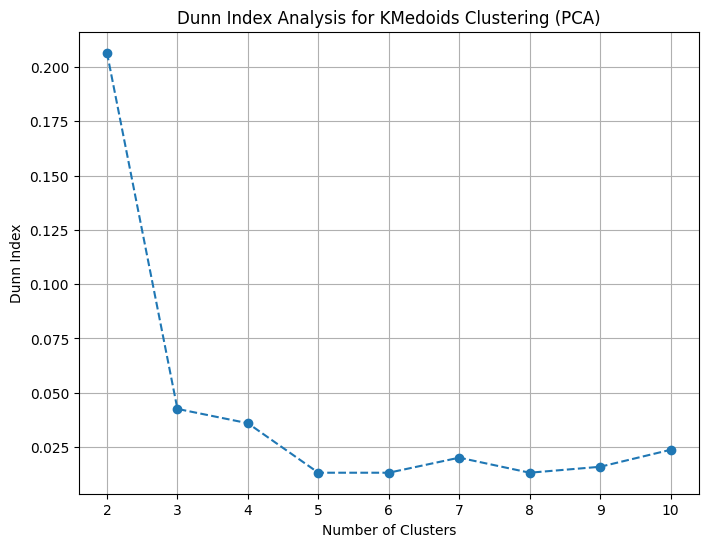

In [ ]:
def dunn_index_kmedoids(data, clusters):
    cluster_indices = [np.where(clusters == cluster)[0] for cluster in np.unique(clusters)]

    max_diameter = max([np.max(pairwise_distances(data[cluster_i])) for cluster_i in cluster_indices])

    inter_cluster_distances = []

    for i, cluster_i in enumerate(cluster_indices):
        for j, cluster_j in enumerate(cluster_indices):
            if i != j and len(cluster_i) > 0 and len(cluster_j) > 0:
                distance_matrix = pairwise_distances(data[cluster_i], data[cluster_j])
                min_distance = np.min(distance_matrix)
                inter_cluster_distances.append(min_distance)

    if len(inter_cluster_distances) == 0:
        return np.nan

    min_inter_cluster_distance = np.min(inter_cluster_distances)

    return min_inter_cluster_distance / max_diameter

scaler_pca_kmedoids = StandardScaler()
scaled_data_pca_kmedoids = scaler_pca_kmedoids.fit_transform(new_pca_kmediods)

range_n_clusters_pca_kmedoids = [2, 3, 4, 5, 6, 7, 8, 9, 10]
dunn_scores_pca_kmedoids = []

for n_clusters_pca_kmedoids in range_n_clusters_pca_kmedoids:
    kmedoids = KMedoids(n_clusters=n_clusters_pca_kmedoids, random_state=42)

    clusters = kmedoids.fit_predict(scaled_data_pca_kmedoids)

    dunn_score = dunn_index_kmedoids(scaled_data_pca_kmedoids, clusters)
    dunn_scores_pca_kmedoids.append(dunn_score)
    print(f"For n_clusters = {n_clusters_pca_kmedoids}, the Dunn index is {dunn_score:.3f}")

plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters_pca_kmedoids, dunn_scores_pca_kmedoids, marker='o', linestyle='--')
plt.title('Dunn Index Analysis for KMedoids Clustering (PCA)')
plt.xlabel('Number of Clusters')
plt.ylabel('Dunn Index')
plt.grid(True)
plt.show()


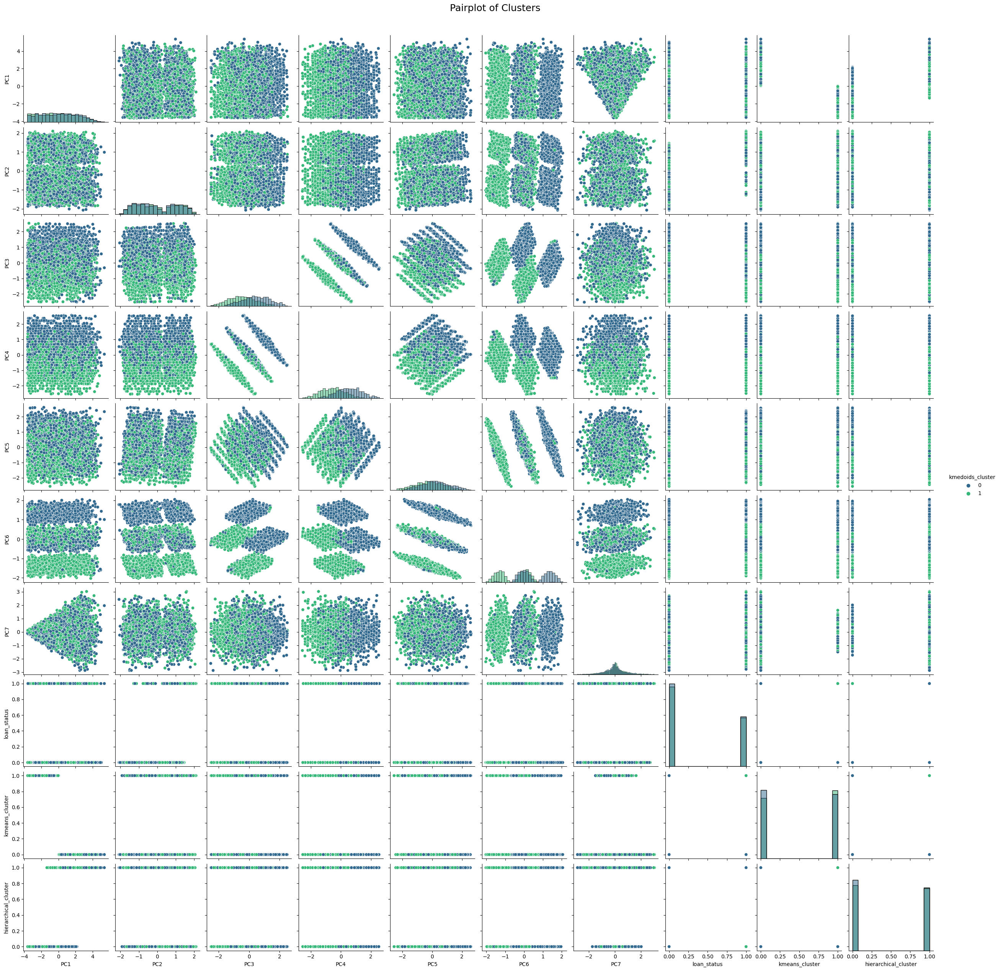

In [ ]:
sns.pairplot(df_pca, hue='kmedoids_cluster', palette='viridis', diag_kind='hist', markers='o', height=2.5)
plt.suptitle('Pairplot of Clusters', y=1.02, fontsize=18)
plt.show()

In [ ]:
df_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,loan_status,kmeans_cluster,hierarchical_cluster,kmedoids_cluster
0,2.922702,-1.232569,0.830458,1.178553,0.138842,0.029089,2.503929,0,0,1,0
1,-1.279552,1.098302,-1.342325,-0.292549,-1.619546,0.420999,0.116247,1,1,0,1
2,3.218276,0.840264,0.303148,1.545397,1.357967,-0.461177,0.210906,1,0,1,0
3,2.481714,0.907908,1.436980,0.518026,-0.037937,0.004553,-1.402466,1,0,1,0
4,2.441534,1.623087,-1.298327,-0.991190,1.763142,-0.372730,0.029391,1,0,1,1


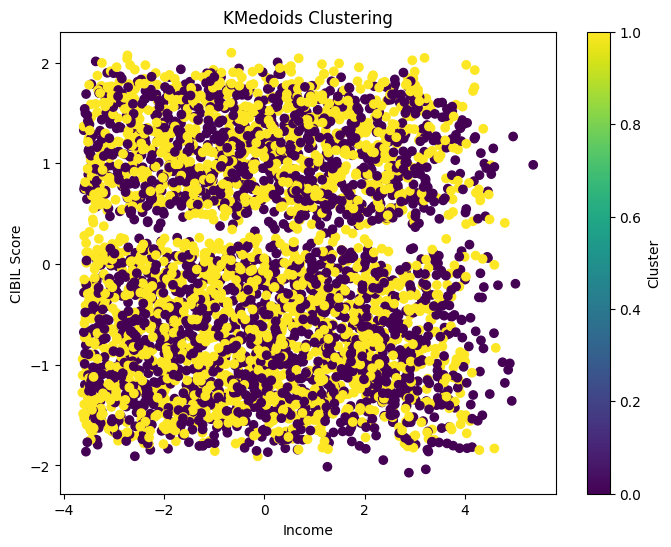

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['kmedoids_cluster'], cmap='viridis')
plt.title('KMedoids Clustering')
plt.xlabel('Income')
plt.ylabel('CIBIL Score')
plt.colorbar(label='Cluster')
plt.show()